In [1]:
import torch 
import torch.nn as nn 
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.metrics import multilabel_confusion_matrix, accuracy_score
%matplotlib inline

In [2]:
path_to_train='TrainSubClass/'
path_to_test='TestSubClass/'
X_train=np.load(path_to_train+"X_train.npy",allow_pickle=True)
Y_train=np.load(path_to_train+"Y_train.npy",allow_pickle=True)
X_test=np.load(path_to_test+"X_test.npy",allow_pickle=True)
Y_test=np.load(path_to_test+"Y_test.npy",allow_pickle=True)

In [3]:
import seaborn as sns
def calc_confusion_matrix(model, X, Y):
    model.eval()
    y_pred = model(torch.Tensor(X)).data.round().int()
    cm = multilabel_confusion_matrix(Y.data.int(), y_pred)
    accurancy = accuracy_score(Y.data.int(), y_pred)
    print("Accurancy {:.2f}%\n".format(100 * accurancy))
    return cm

In [4]:
def print_confusion_matrix(confusion_matrix, axes, class_label, class_names, epoch_number, fontsize=14):
    df_cm = pd.DataFrame(confusion_matrix, index=class_names, columns=class_names,)
    heatmap = sns.heatmap(df_cm, annot=True, fmt="d", cbar=False, ax=axes)
    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    axes.set_ylabel('True label')
    axes.set_xlabel('Predicted label')
    axes.set_title(f"Epoch Number № {epoch_number}" + " Class - " + class_label)

In [5]:
def train(epoch, my_model):
    losses = []
    my_model.train()
    for batch_id, (X_batch, Y_batch) in enumerate(train_loader):
        optimizer.zero_grad() 
        output = my_model(X_batch)
        loss = loss_function(output, Y_batch.float())
        loss.backward()
        optimizer.step()
        if batch_id % 100 == 0:
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                epoch, batch_id * len(X_batch), len(train_loader.dataset),
                100. * batch_id / len(train_loader), loss.item()))
        losses.append(loss.data.numpy())
    return np.mean(losses)

In [6]:
def test(my_model):
    my_model.eval()
    test_loss = 0
    correct = 0
    y_pred = []
    acc_arr = []
    for X_batch, Y_batch in test_loader: 
        output = my_model(X_batch)
        test_loss += loss_function(output, Y_batch.float()).data
        pred = output.data.round().int()
        acc_arr.append(accuracy_score(Y_batch.data.int(), pred))
        correct += pred.eq(Y_batch.data.int().view_as(pred)).cpu().sum()
    summary = 0
    for i in acc_arr:
        summary += i
    test_loss /= len(test_loader)
    acc = summary/ len(acc_arr)
    # acc = accuracy_score(test_loader.dataset, y_pred)
    # print('\nTest set: Average loss: {:.4f} Accurancy: {:.2f}%\n'.format(test_loss, 100 * summary / len(acc_arr)))
    return acc, test_loss

In [7]:
from sklearn.metrics import confusion_matrix, accuracy_score
from torch.utils.data import TensorDataset, DataLoader

batch_size = 64
input_shape = X_train.shape[1]

X_train_tensor = torch.Tensor(X_train)
Y_train_tensor = torch.LongTensor(Y_train)

train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size = batch_size, shuffle = True)

X_test_tensor = torch.Tensor(X_test)
Y_test_tensor = torch.LongTensor(Y_test)

test_dataset = TensorDataset(X_test_tensor, Y_test_tensor)
test_loader = DataLoader(test_dataset, batch_size = batch_size, shuffle = True)

In [8]:
model1=nn.Sequential()
model1.add_module("dense1",nn.Linear(input_shape,132))
model1.add_module("relu1",nn.ReLU())
model1.add_module("dense2",nn.Linear(132,132))
model1.add_module("relu2",nn.ReLU())
model1.add_module("dense3", nn.Linear(132,23))
model1.add_module("sigmoid",nn.Sigmoid())

loss_function = nn.BCELoss()
optimizer = torch.optim.Adam(model1.parameters())

In [9]:
loss_train_fst=[]
loss_test_fst=[]
acc_fst=[]
cm_arr = []
for epoch in range(25):
    loss_train_fst.append(train(epoch + 1,model1))
    acc_,test_loss_=test(model1)
    acc_fst.append(acc_)
    loss_test_fst.append(test_loss_)
    cm_arr.append(calc_confusion_matrix(model1, X_test_tensor, Y_test_tensor))

Train Epoch: 1 [0/15001 (0%)]	Loss: 0.698262
Train Epoch: 1 [6400/15001 (43%)]	Loss: 0.206931
Train Epoch: 1 [12800/15001 (85%)]	Loss: 0.203524
Accurancy 24.97%

Train Epoch: 2 [0/15001 (0%)]	Loss: 0.232250
Train Epoch: 2 [6400/15001 (43%)]	Loss: 0.191472
Train Epoch: 2 [12800/15001 (85%)]	Loss: 0.192391
Accurancy 24.23%

Train Epoch: 3 [0/15001 (0%)]	Loss: 0.151041
Train Epoch: 3 [6400/15001 (43%)]	Loss: 0.141639
Train Epoch: 3 [12800/15001 (85%)]	Loss: 0.153907
Accurancy 28.98%

Train Epoch: 4 [0/15001 (0%)]	Loss: 0.113709
Train Epoch: 4 [6400/15001 (43%)]	Loss: 0.143195
Train Epoch: 4 [12800/15001 (85%)]	Loss: 0.132375
Accurancy 28.70%

Train Epoch: 5 [0/15001 (0%)]	Loss: 0.078650
Train Epoch: 5 [6400/15001 (43%)]	Loss: 0.087557
Train Epoch: 5 [12800/15001 (85%)]	Loss: 0.109253
Accurancy 29.96%

Train Epoch: 6 [0/15001 (0%)]	Loss: 0.081348
Train Epoch: 6 [6400/15001 (43%)]	Loss: 0.064474
Train Epoch: 6 [12800/15001 (85%)]	Loss: 0.074043
Accurancy 28.01%

Train Epoch: 7 [0/15001 (0%)

------------------CONFUSION MATRIX FOR EPOCHS ---------------------


C:\Users\micro\AppData\Local\Temp\ipykernel_820\1505892843.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")


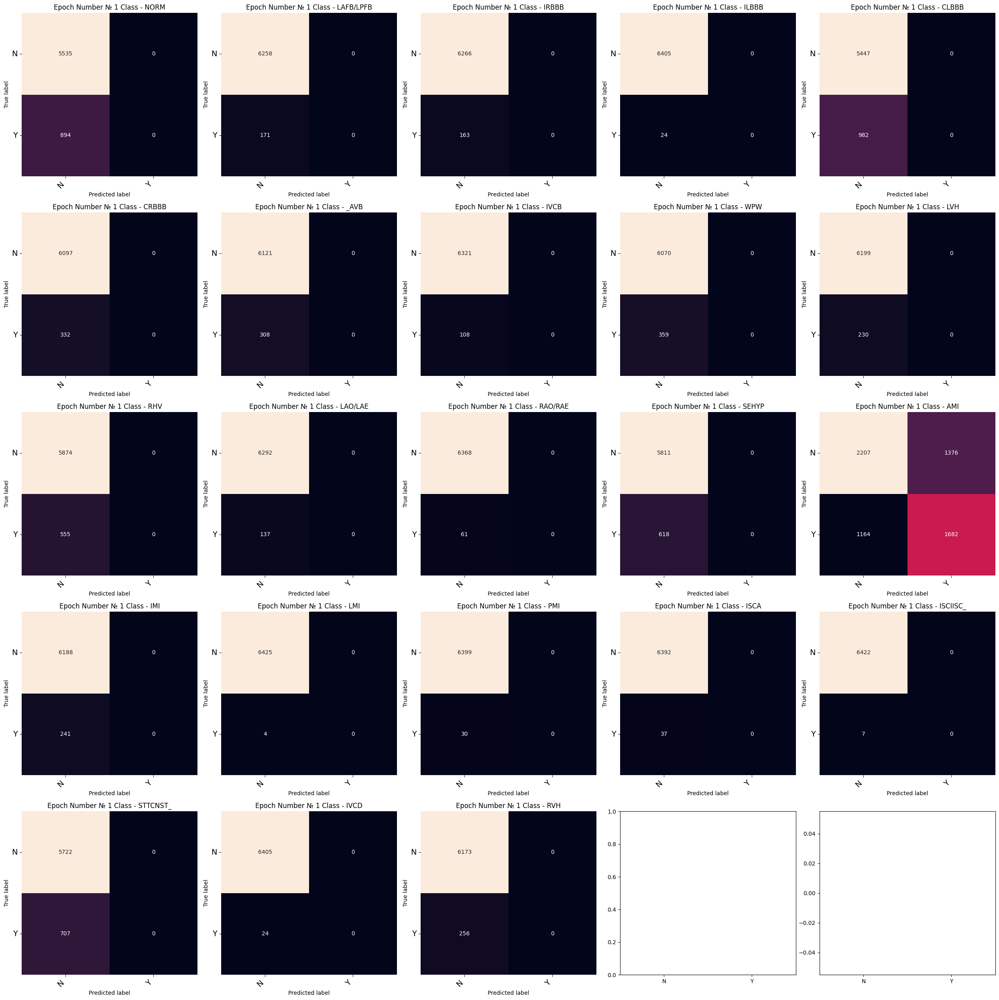

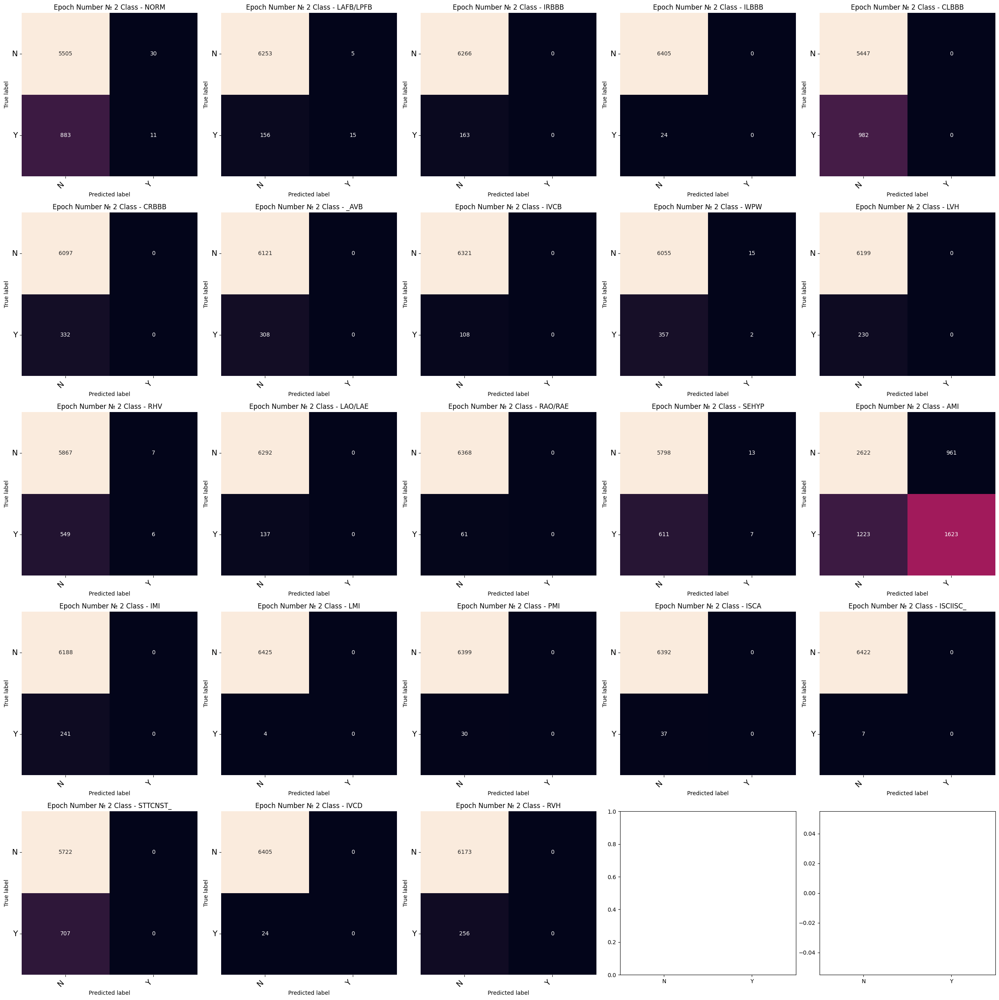

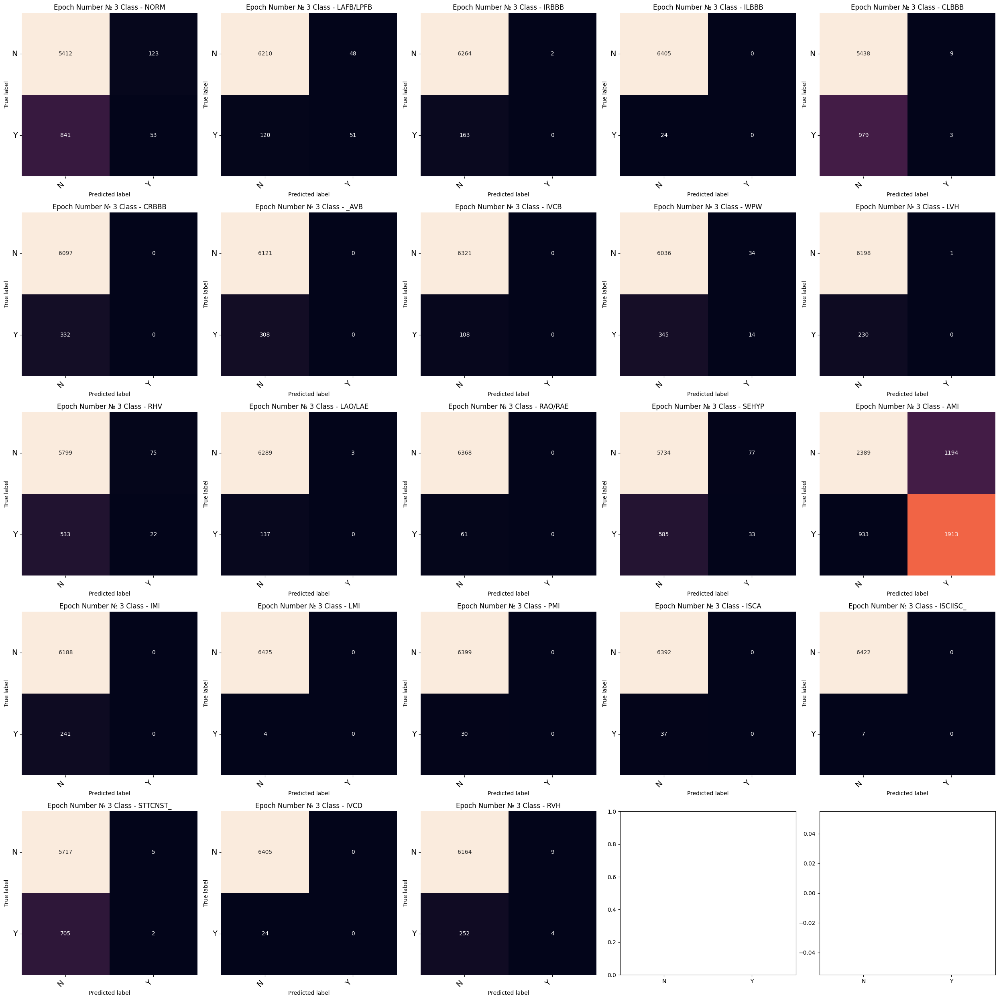

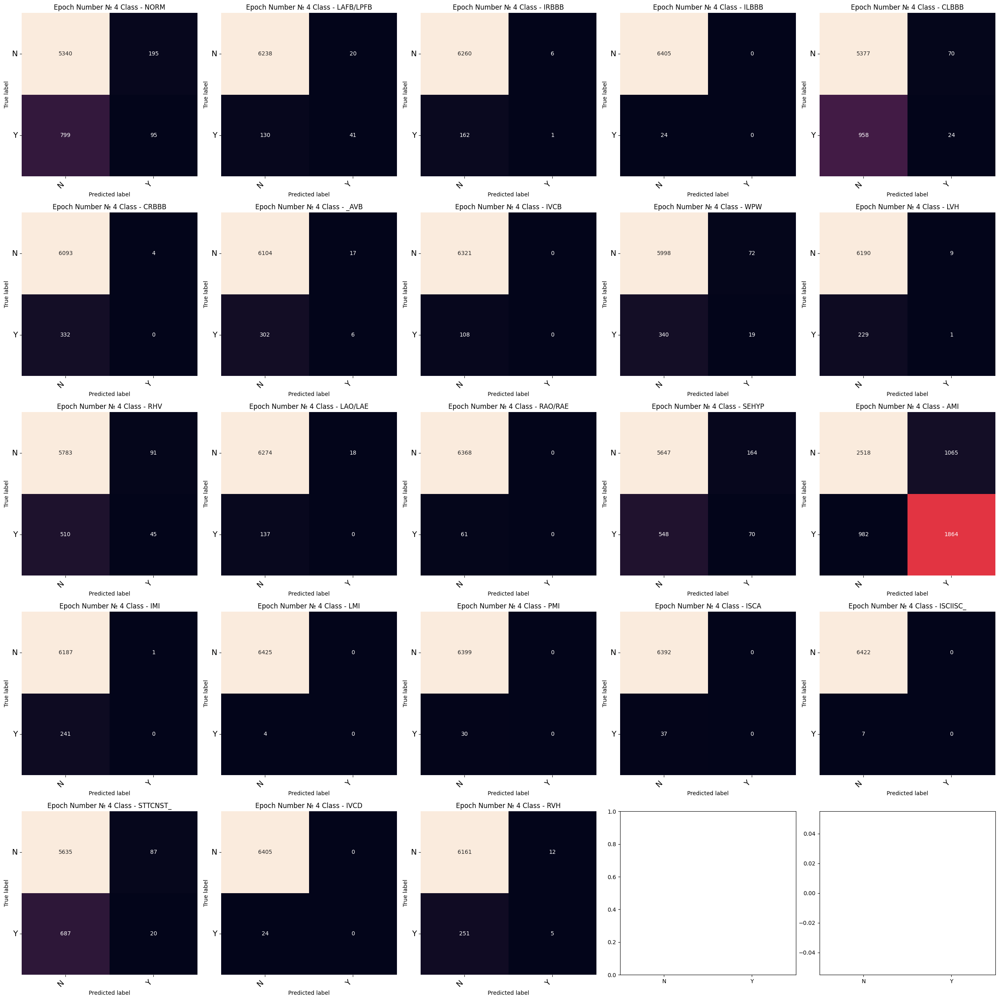

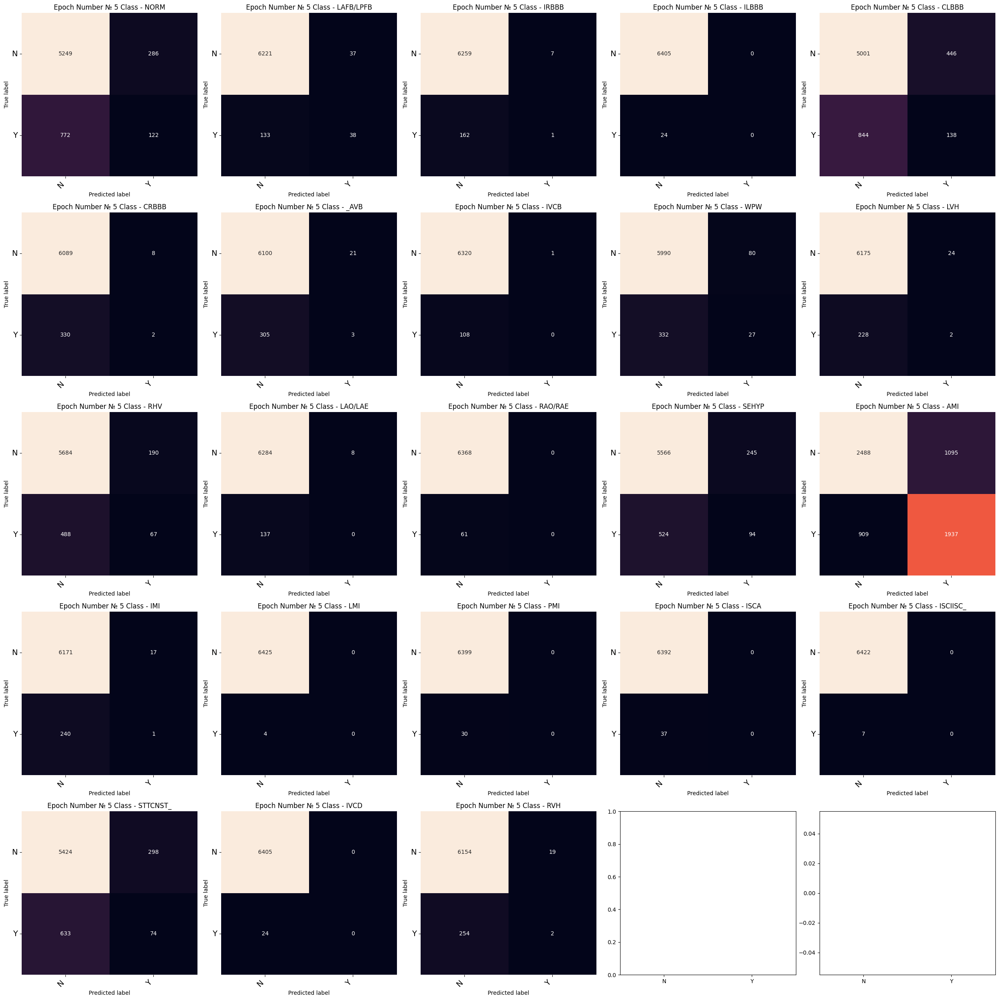

...

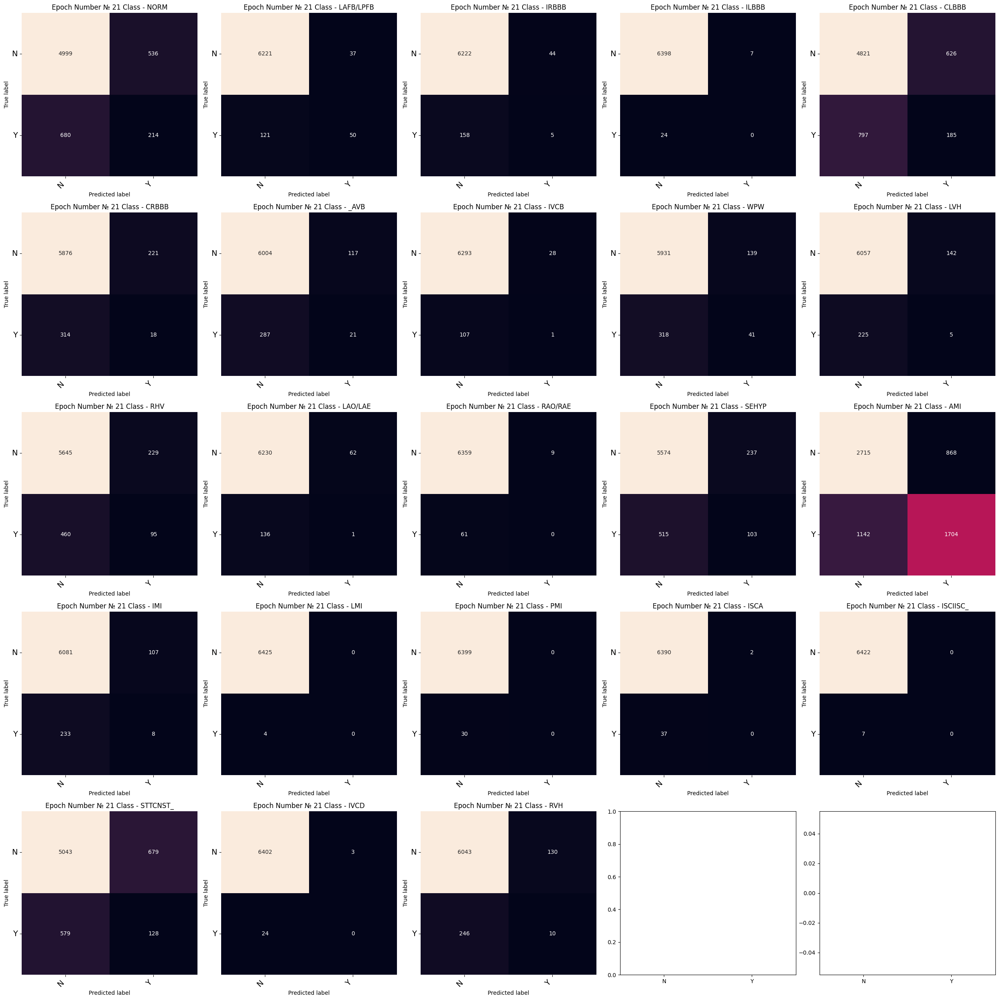

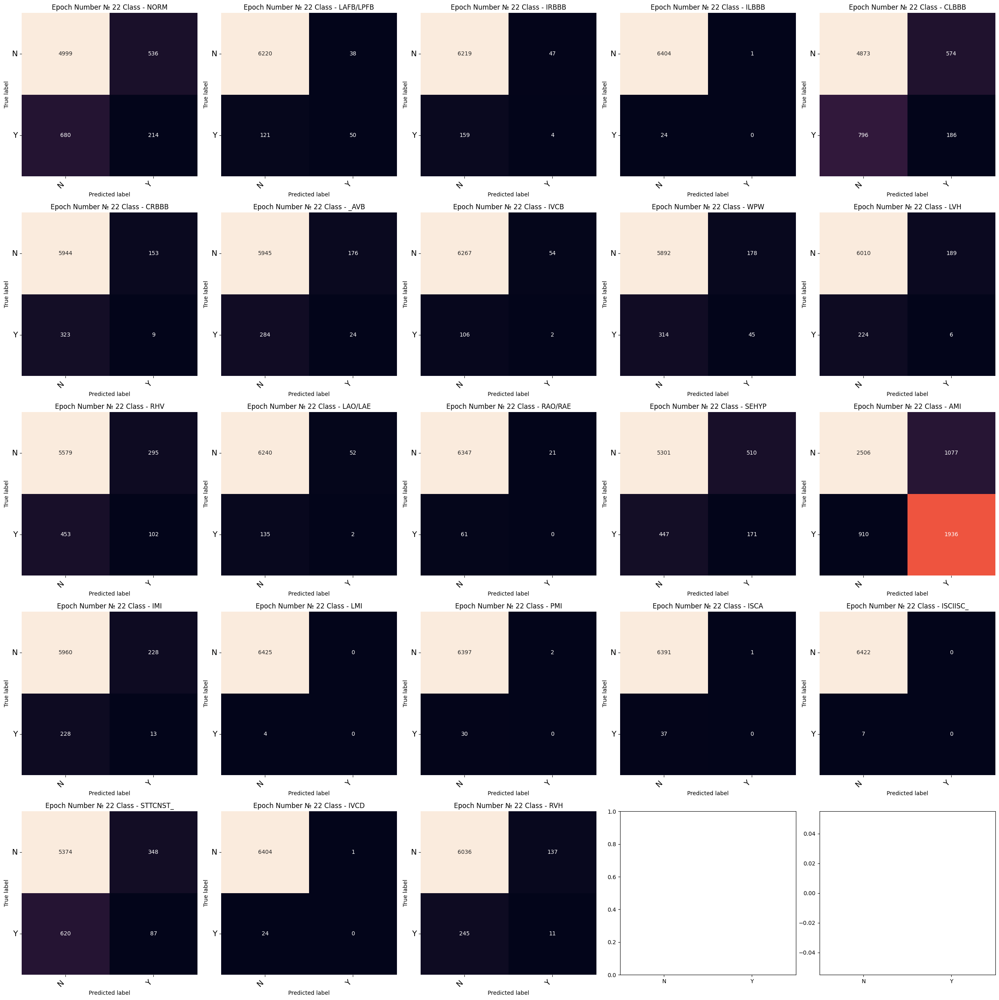

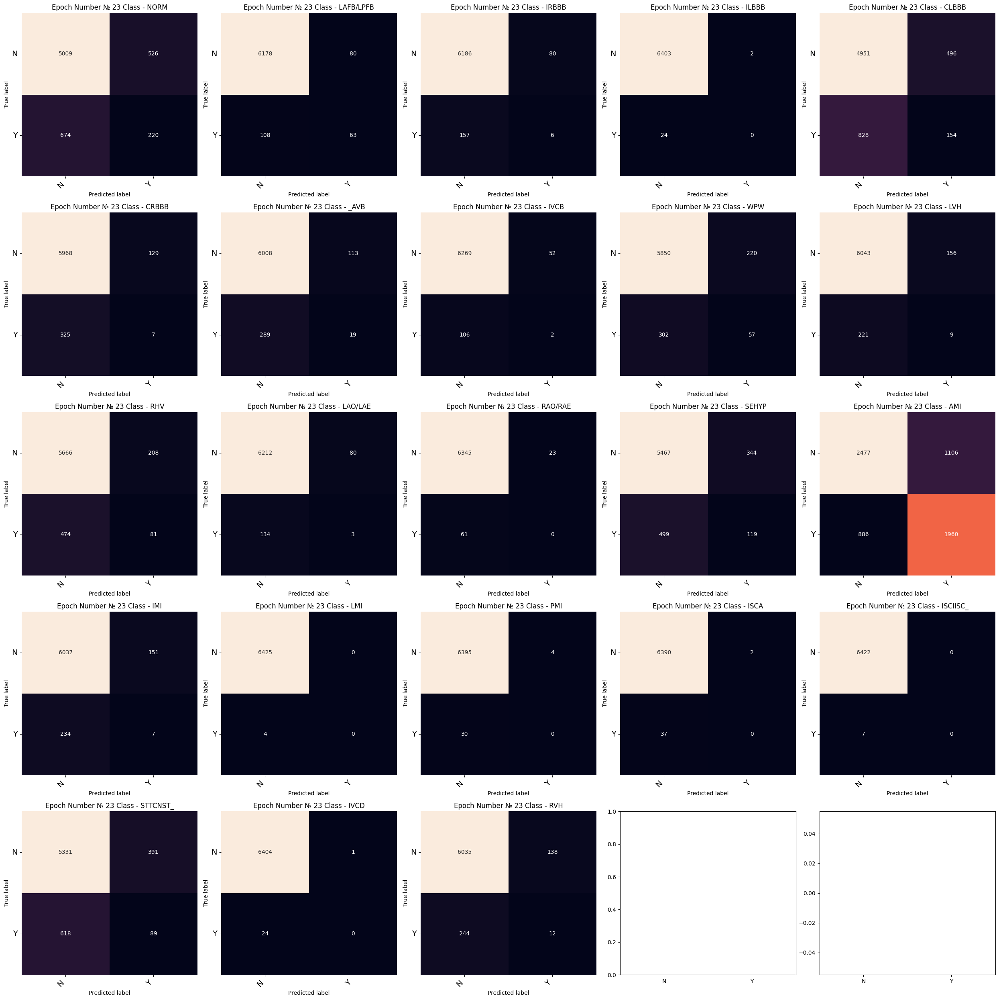

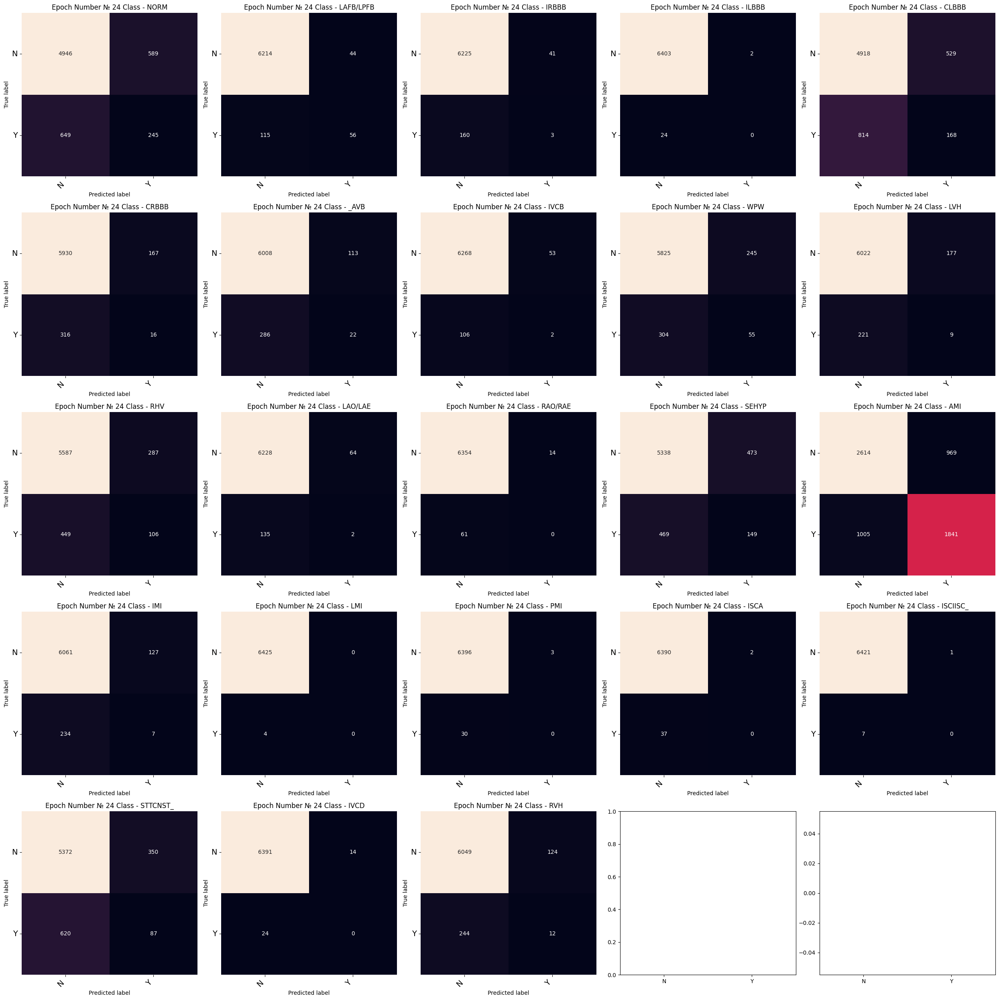

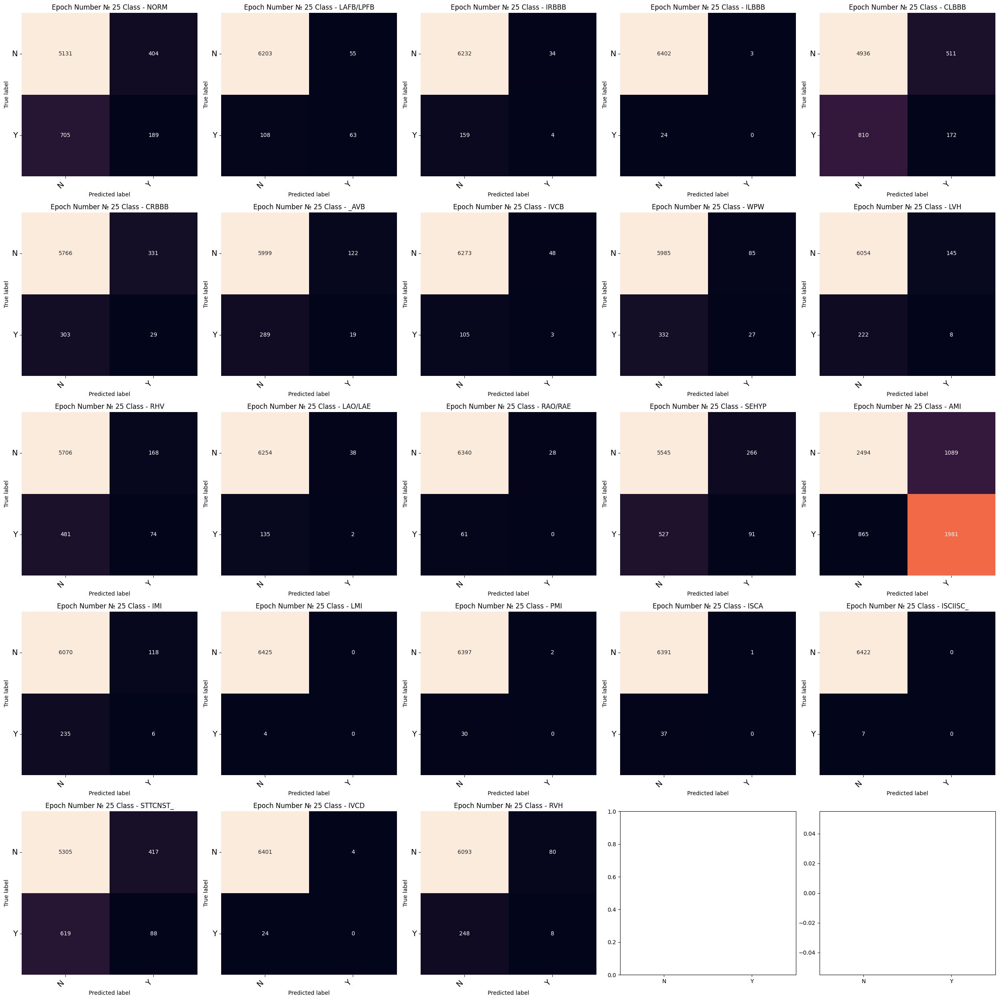

In [10]:
labels = ['NORM','LAFB/LPFB', 'IRBBB', 'ILBBB', 'CLBBB', 'CRBBB', '_AVB', 'IVCB', 'WPW', 'LVH', 'RHV', 'LAO/LAE', 'RAO/RAE', 'SEHYP', 'AMI', 'IMI', 'LMI', 'PMI','ISCA','ISCI''ISC_','STTC''NST_','IVCD','RVH']
index = 1
print(f"------------------CONFUSION MATRIX FOR EPOCHS ---------------------")
for cm in cm_arr:
    fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")
    for axes, cfs_matrix, label in zip(ax.flatten(), cm, labels):
        print_confusion_matrix(cfs_matrix, axes, label, ["N", "Y"], index)
    fig.tight_layout()
    plt.plot()
    index +=1

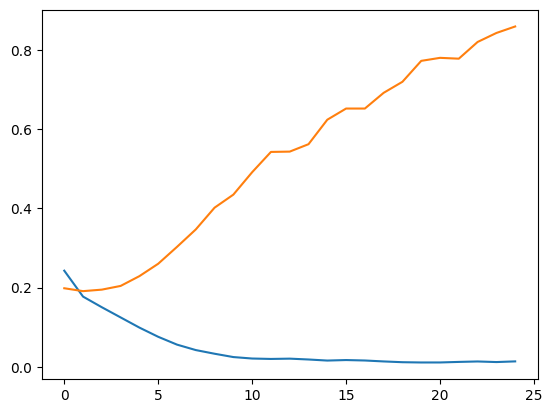

In [11]:
plt.plot(loss_train_fst)
plt.plot(loss_test_fst)
plt.show()

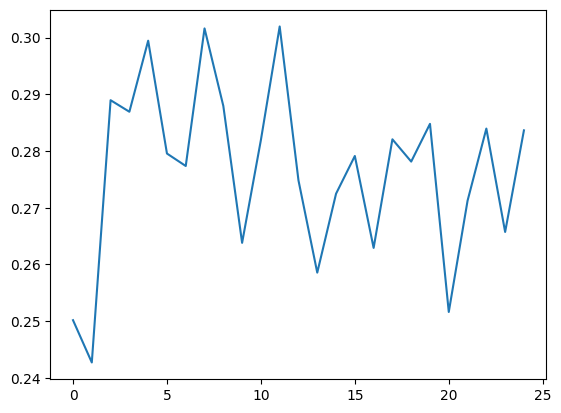

In [12]:
plt.plot(acc_fst)
plt.show()

In [13]:
model2=nn.Sequential()
model2.add_module("dense1",nn.Linear(input_shape,132))
model2.add_module("flattern", nn.Flatten())
model2.add_module("bn1", nn.InstanceNorm1d(132))
model2.add_module("relu1",nn.ReLU())
model2.add_module("dense2",nn.Linear(132,132))
model2.add_module("relu2",nn.ReLU())
model2.add_module("dense3", nn.Linear(132,23))
model2.add_module("softmax",nn.Sigmoid())

loss_function = nn.BCELoss()
optimizer = torch.optim.Adam(model2.parameters())

loss_train_sec = []
loss_test_sec = []
acc_sec = []
cm_arr = []

for epoch in range(25):
    loss_train_sec.append(train(epoch + 1, model2))
    _acc,_test_loss = test(model2)
    acc_sec.append(_acc)
    loss_test_sec.append(_test_loss)
    cm_arr.append(calc_confusion_matrix(model2, X_test_tensor, Y_test_tensor))

Train Epoch: 1 [0/15001 (0%)]	Loss: 0.709630
Train Epoch: 1 [6400/15001 (43%)]	Loss: 0.139300
Train Epoch: 1 [12800/15001 (85%)]	Loss: 0.170704
Accurancy 22.59%

Train Epoch: 2 [0/15001 (0%)]	Loss: 0.171583
Train Epoch: 2 [6400/15001 (43%)]	Loss: 0.177859
Train Epoch: 2 [12800/15001 (85%)]	Loss: 0.149967
Accurancy 29.90%

Train Epoch: 3 [0/15001 (0%)]	Loss: 0.124637
Train Epoch: 3 [6400/15001 (43%)]	Loss: 0.153499
Train Epoch: 3 [12800/15001 (85%)]	Loss: 0.124826
Accurancy 33.13%

Train Epoch: 4 [0/15001 (0%)]	Loss: 0.123381
Train Epoch: 4 [6400/15001 (43%)]	Loss: 0.114225
Train Epoch: 4 [12800/15001 (85%)]	Loss: 0.110898
Accurancy 26.74%

Train Epoch: 5 [0/15001 (0%)]	Loss: 0.083051
Train Epoch: 5 [6400/15001 (43%)]	Loss: 0.087414
Train Epoch: 5 [12800/15001 (85%)]	Loss: 0.080384
Accurancy 28.37%

Train Epoch: 6 [0/15001 (0%)]	Loss: 0.072145
Train Epoch: 6 [6400/15001 (43%)]	Loss: 0.071987
Train Epoch: 6 [12800/15001 (85%)]	Loss: 0.076582
Accurancy 29.82%

Train Epoch: 7 [0/15001 (0%)

------------------CONFUSION MATRIX FOR EPOCHS ---------------------


C:\Users\micro\AppData\Local\Temp\ipykernel_820\1505892843.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")


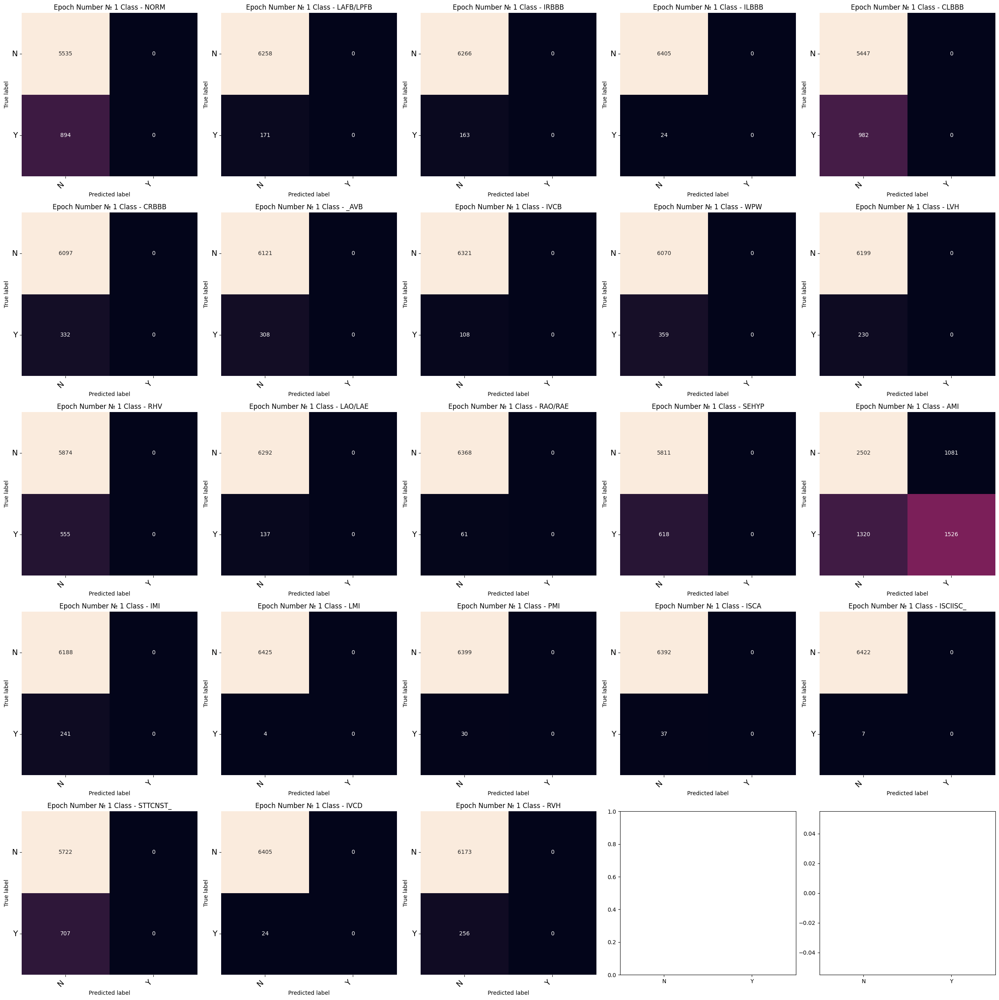

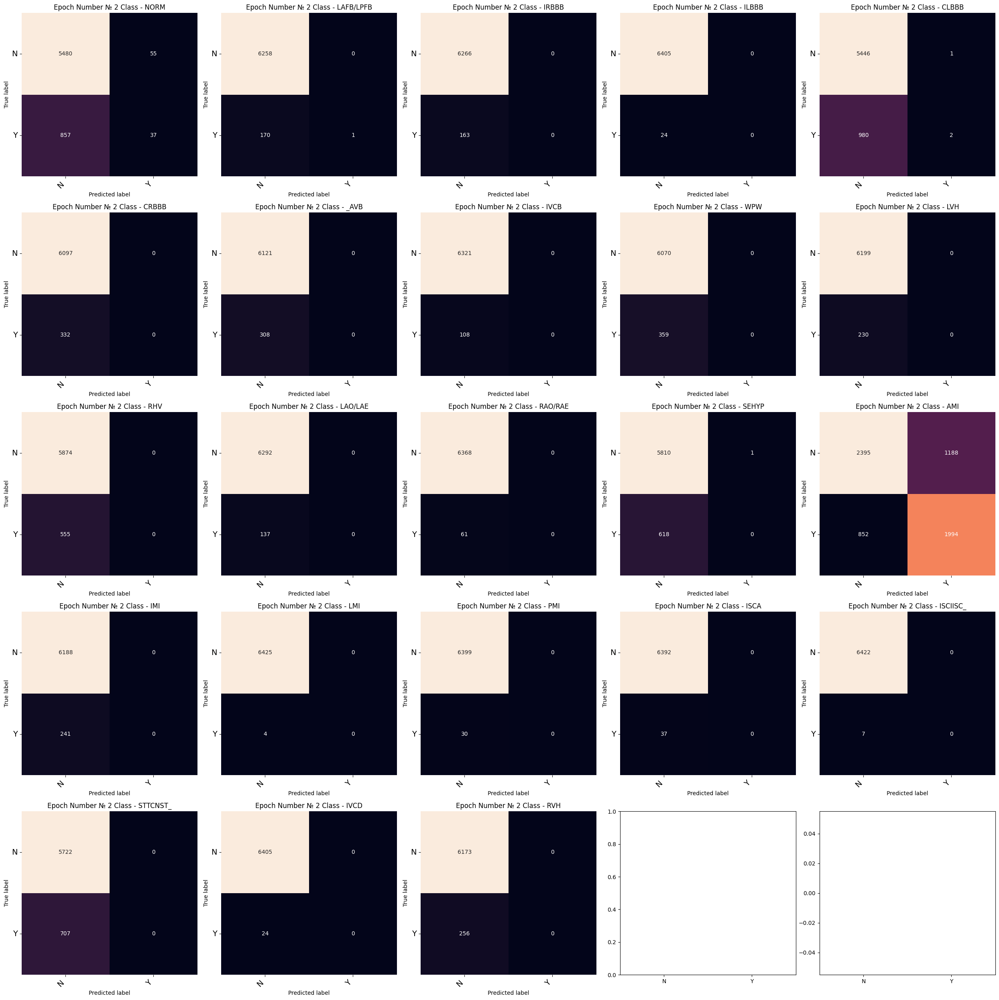

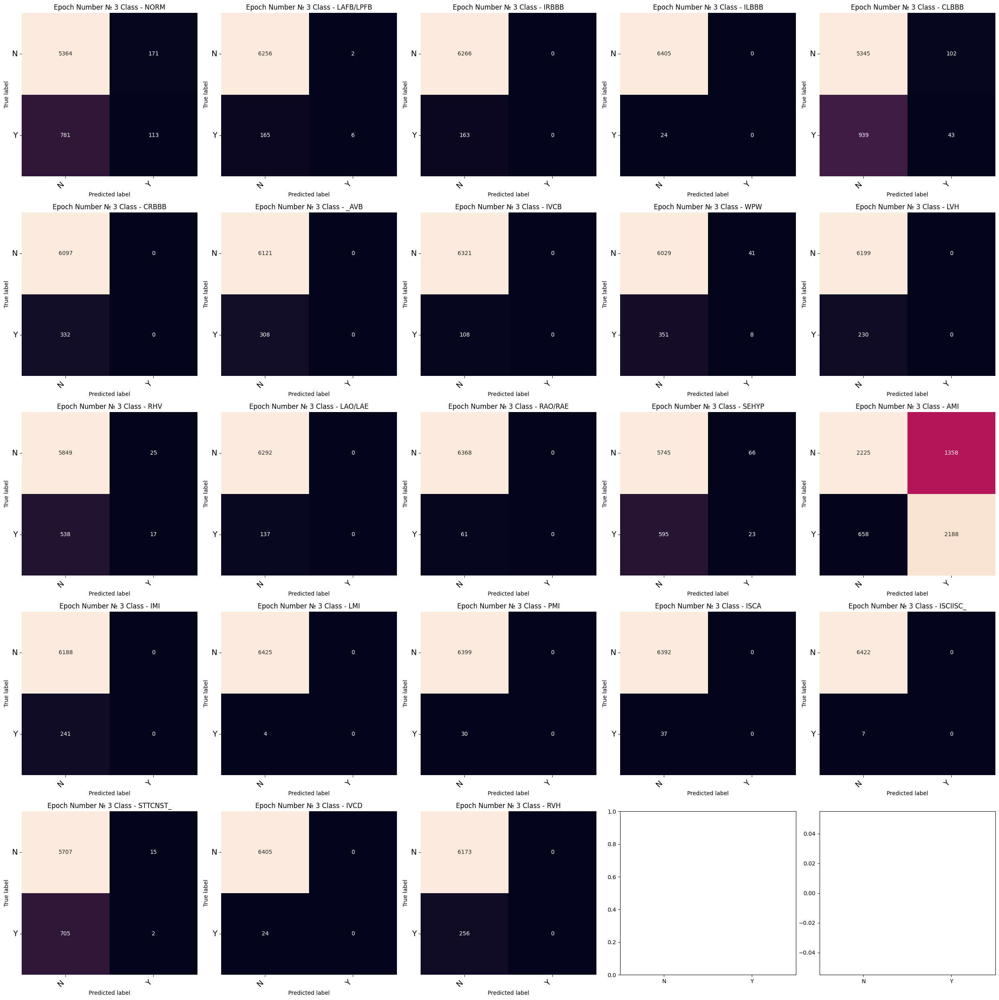

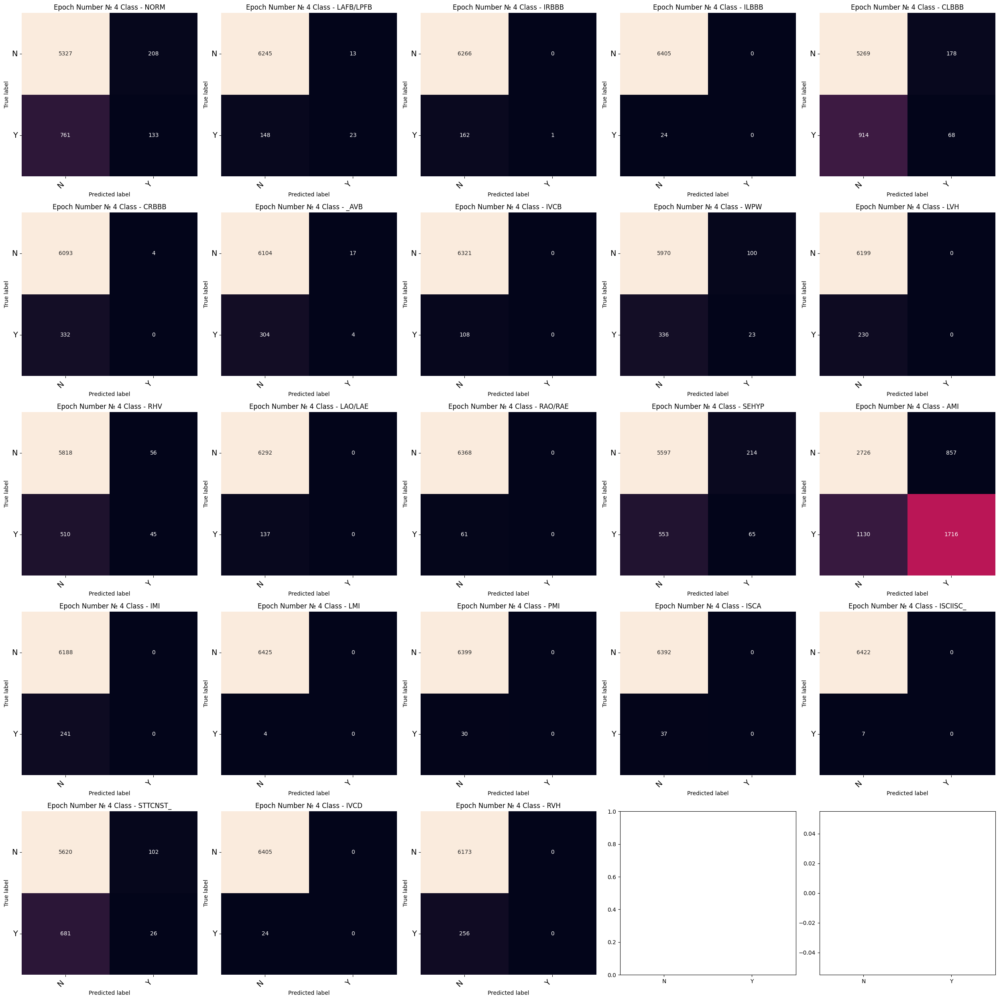

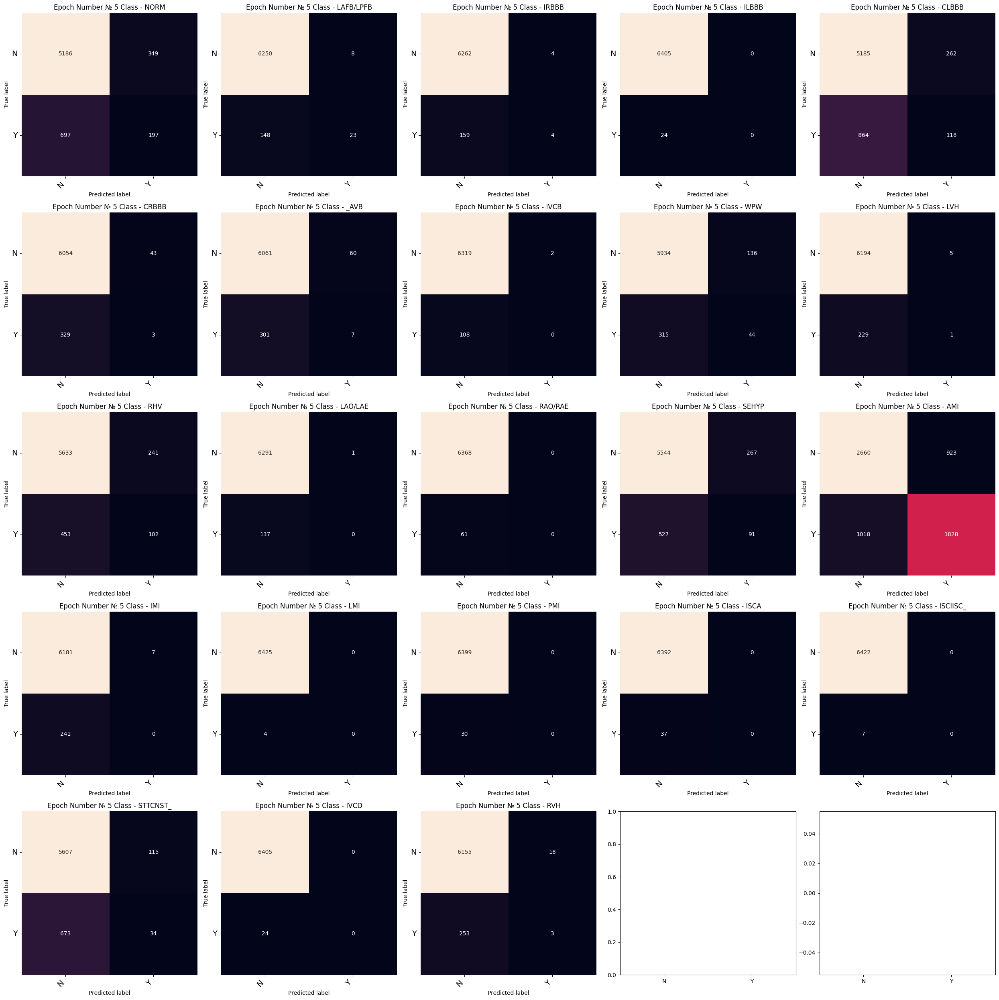

...

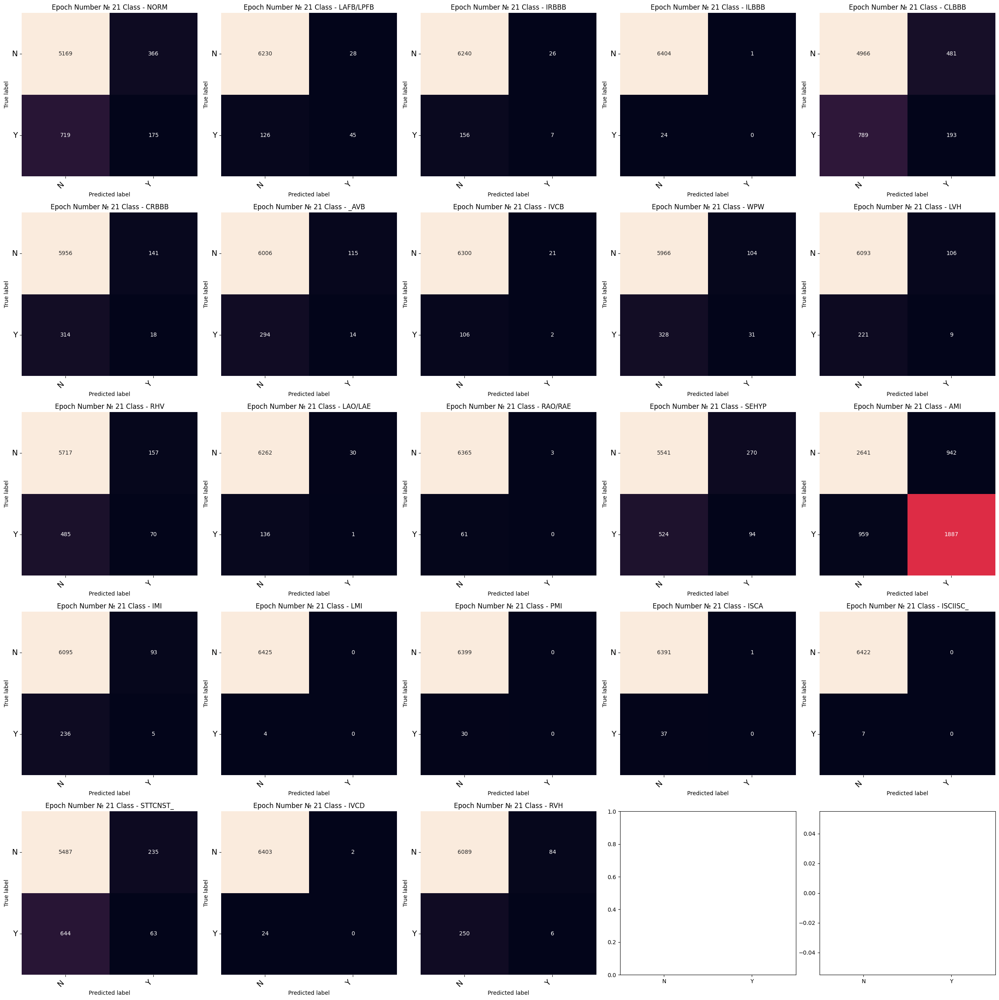

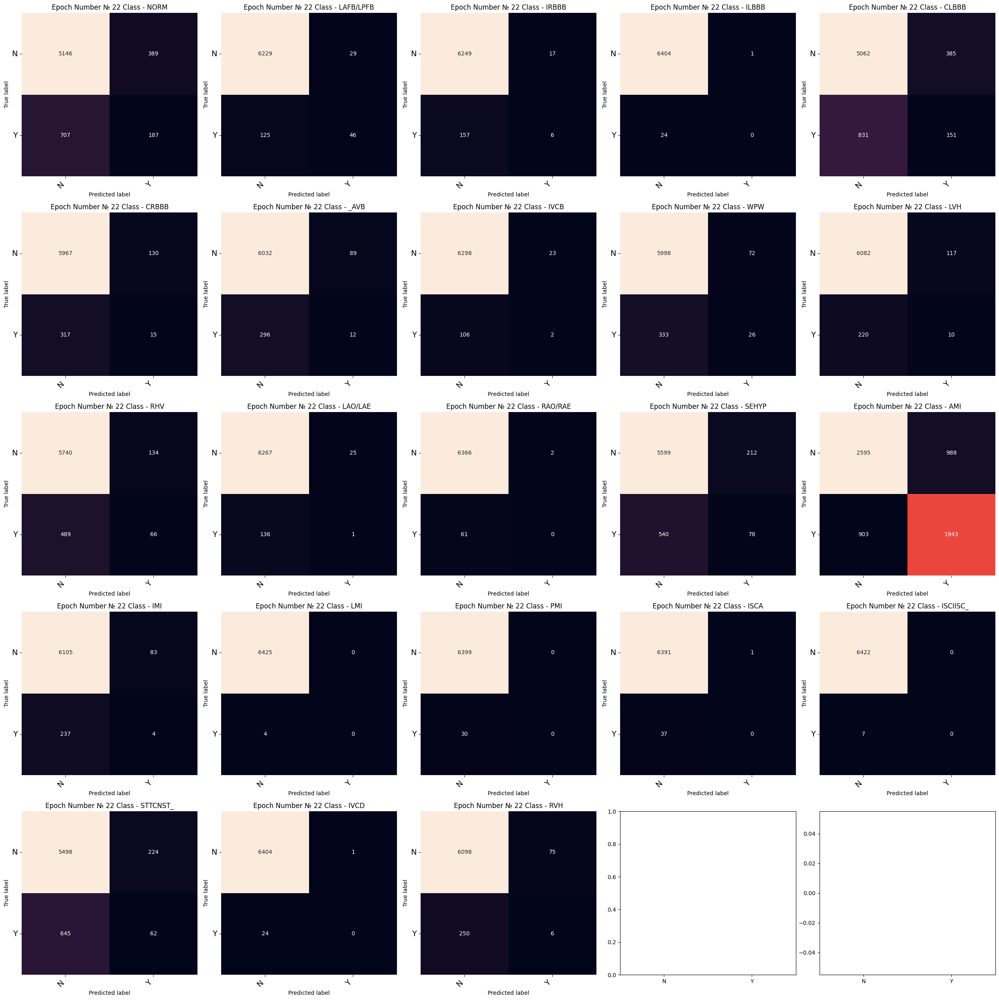

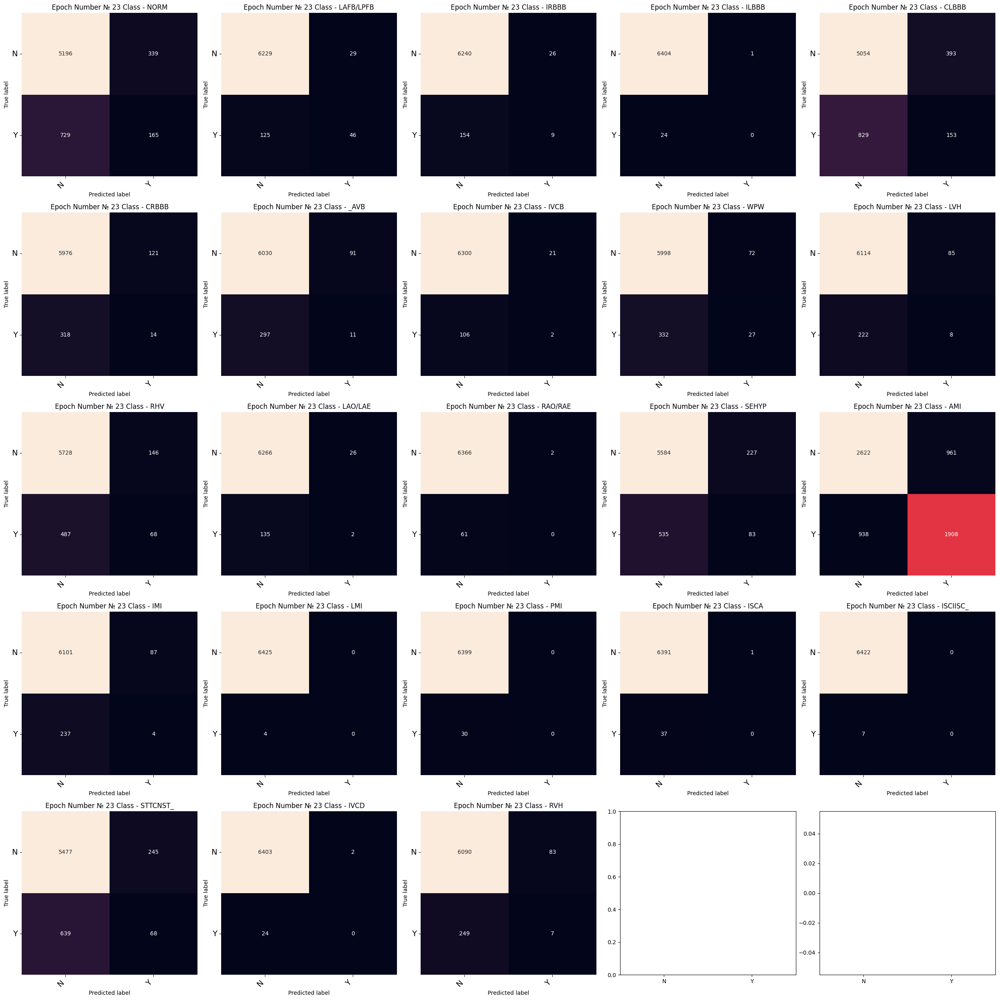

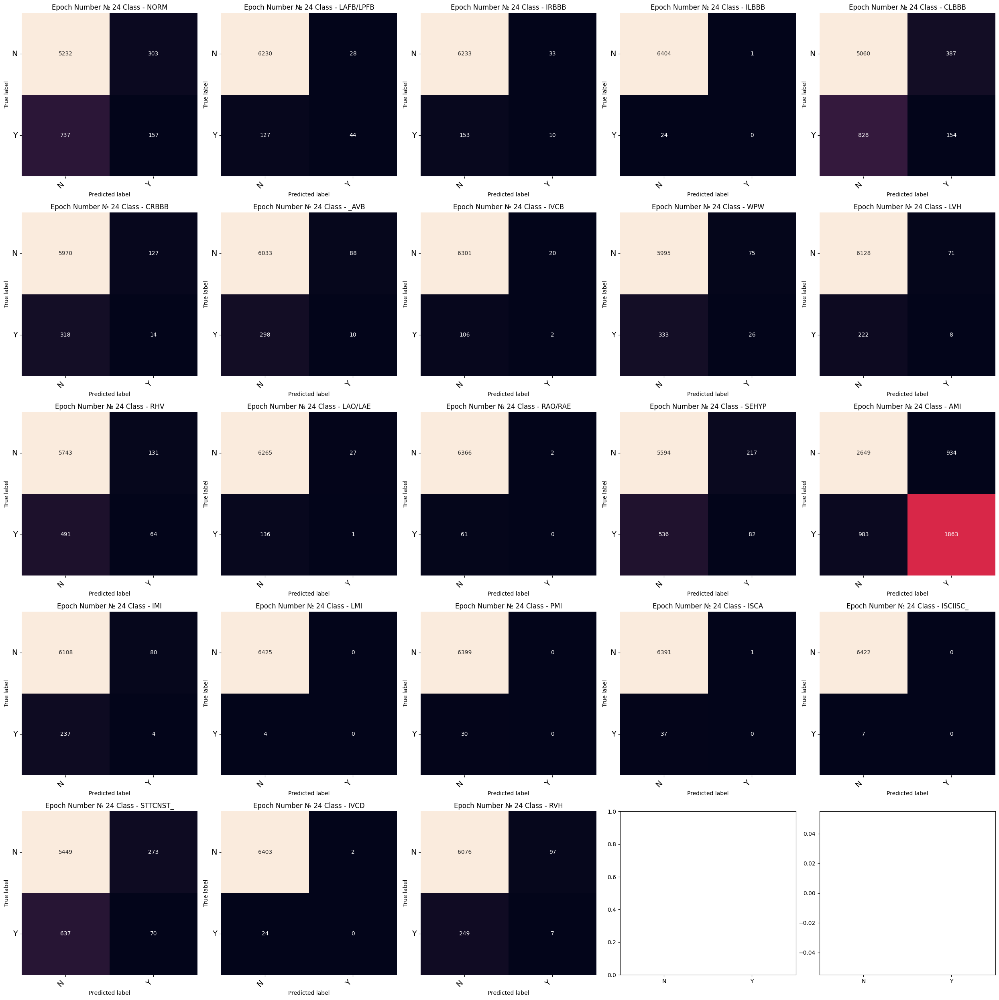

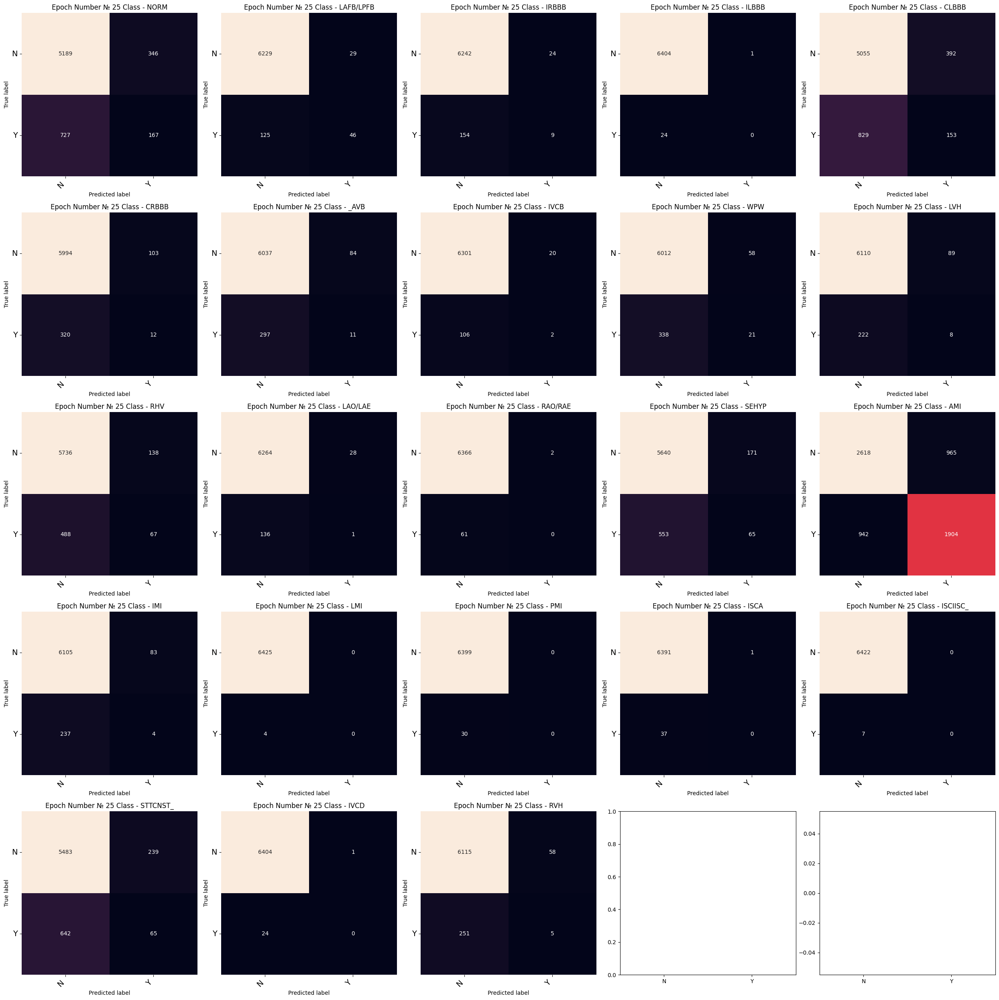

In [14]:
labels = ['NORM','LAFB/LPFB', 'IRBBB', 'ILBBB', 'CLBBB', 'CRBBB', '_AVB', 'IVCB', 'WPW', 'LVH', 'RHV', 'LAO/LAE', 'RAO/RAE', 'SEHYP', 'AMI', 'IMI', 'LMI', 'PMI','ISCA','ISCI''ISC_','STTC''NST_','IVCD','RVH']
index = 1
print(f"------------------CONFUSION MATRIX FOR EPOCHS ---------------------")
for cm in cm_arr:
    fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")
    for axes, cfs_matrix, label in zip(ax.flatten(), cm, labels):
        print_confusion_matrix(cfs_matrix, axes, label, ["N", "Y"], index)
    fig.tight_layout()
    plt.plot()
    index +=1

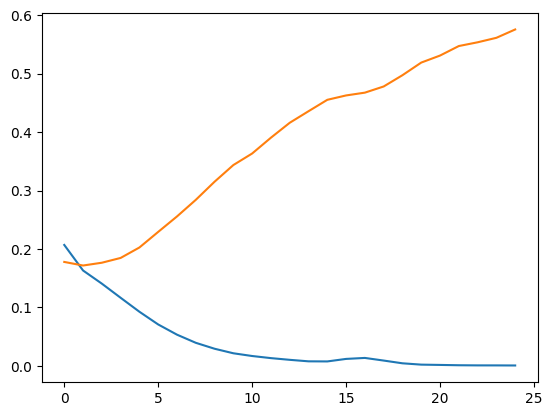

In [15]:
plt.plot(loss_train_sec)
plt.plot(loss_test_sec)
plt.show()

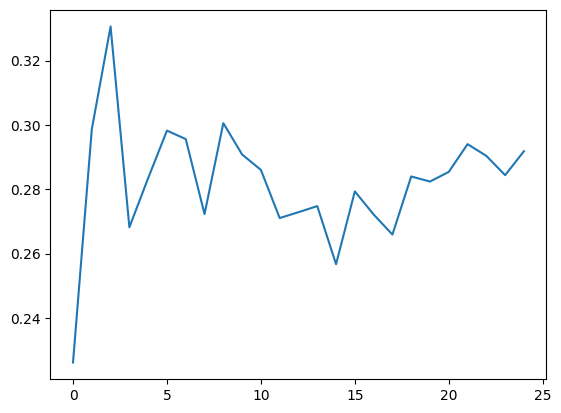

In [16]:
plt.plot(acc_sec)
plt.show()

In [17]:
path_to_train='TrainSubClass/'
path_to_test='TestSubClass/'
X_train=np.load(path_to_train+"X_train.npy",allow_pickle=True)
Y_train=np.load(path_to_train+"Y_train.npy",allow_pickle=True)
X_test=np.load(path_to_test+"X_test.npy",allow_pickle=True)
Y_test=np.load(path_to_test+"Y_test.npy",allow_pickle=True)

In [18]:
from sklearn.metrics import confusion_matrix, accuracy_score
from torch.utils.data import TensorDataset, DataLoader

batch_size = 64
input_shape = X_train.shape[1]

X_train=X_train.reshape(X_train.shape[0],1,12000)
X_test=X_test.reshape(X_test.shape[0],1,12000)

X_train_tensor = torch.Tensor(X_train)
Y_train_tensor = torch.LongTensor(Y_train)

train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size = batch_size, shuffle = True)

X_test_tensor = torch.Tensor(X_test)
Y_test_tensor = torch.LongTensor(Y_test)

test_dataset = TensorDataset(X_test_tensor, Y_test_tensor)
test_loader = DataLoader(test_dataset, batch_size = batch_size, shuffle = True)

In [19]:
model1 = nn.Sequential()
model1.add_module("conv1",nn.Conv1d(in_channels = 1, out_channels = 16, kernel_size = 3))
model1.add_module("relu1",nn.ReLU())
model1.add_module("flattern", nn.Flatten())
model1.add_module("dense1",nn.Linear((input_shape-3+1)*16,264))
model1.add_module("relu2",nn.ReLU())
model1.add_module("AvgPool", nn.AvgPool1d(2))
model1.add_module("relu2",nn.ReLU())
model1.add_module("bn1",nn.BatchNorm1d(132))
model1.add_module("drop1", nn.Dropout(0.5))
model1.add_module("relu3",nn.ReLU())
model1.add_module("dense2",nn.Linear(132,132))
model1.add_module("drop2", nn.Dropout(0.5))
model1.add_module("relu4",nn.ReLU())
model1.add_module("dense3", nn.Linear(132,23))
model1.add_module("softmax",nn.Sigmoid())

loss_function=nn.BCELoss()
optimizer = torch.optim.Adam(model1.parameters(), lr=0.0001)

In [20]:
loss_train_th=[]
loss_test_th=[]
acc_th=[]
cm_arr = []
for epoch in range(25):
    loss_train_th.append(train(epoch + 1,model1))
    acc_,test_loss_=test(model1)
    acc_th.append(acc_)
    loss_test_th.append(test_loss_)
    cm_arr.append(calc_confusion_matrix(model1, X_test_tensor, Y_test_tensor))

Train Epoch: 1 [0/15001 (0%)]	Loss: 0.709245
Train Epoch: 1 [6400/15001 (43%)]	Loss: 0.512879
Train Epoch: 1 [12800/15001 (85%)]	Loss: 0.276912
Accurancy 0.03%

Train Epoch: 2 [0/15001 (0%)]	Loss: 0.239184
Train Epoch: 2 [6400/15001 (43%)]	Loss: 0.219396
Train Epoch: 2 [12800/15001 (85%)]	Loss: 0.198701
Accurancy 17.89%

Train Epoch: 3 [0/15001 (0%)]	Loss: 0.170142
Train Epoch: 3 [6400/15001 (43%)]	Loss: 0.210409
Train Epoch: 3 [12800/15001 (85%)]	Loss: 0.196415
Accurancy 28.08%

Train Epoch: 4 [0/15001 (0%)]	Loss: 0.194131
Train Epoch: 4 [6400/15001 (43%)]	Loss: 0.206325
Train Epoch: 4 [12800/15001 (85%)]	Loss: 0.197923
Accurancy 38.90%

Train Epoch: 5 [0/15001 (0%)]	Loss: 0.163795
Train Epoch: 5 [6400/15001 (43%)]	Loss: 0.157798
Train Epoch: 5 [12800/15001 (85%)]	Loss: 0.163411
Accurancy 15.79%

Train Epoch: 6 [0/15001 (0%)]	Loss: 0.175518
Train Epoch: 6 [6400/15001 (43%)]	Loss: 0.176214
Train Epoch: 6 [12800/15001 (85%)]	Loss: 0.187346
Accurancy 41.69%

Train Epoch: 7 [0/15001 (0%)]

------------------CONFUSION MATRIX FOR EPOCHS ---------------------


C:\Users\micro\AppData\Local\Temp\ipykernel_820\1505892843.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")


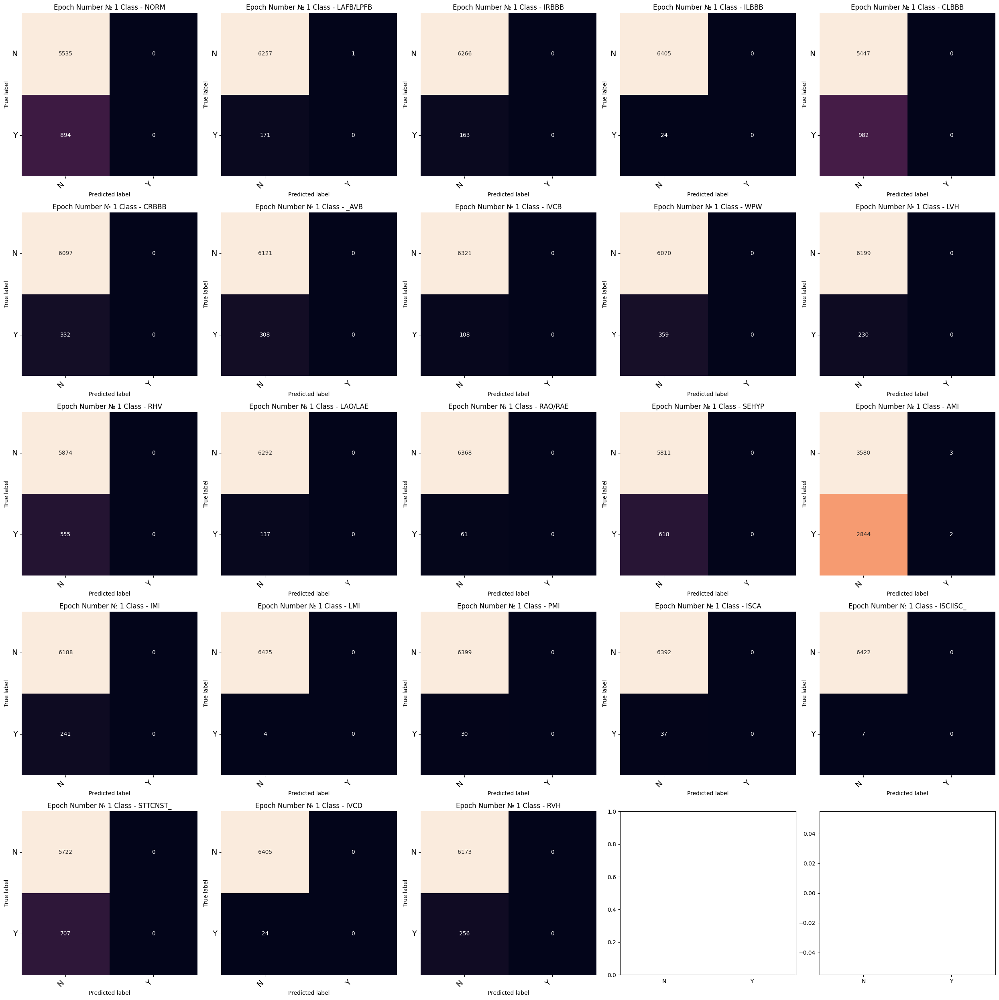

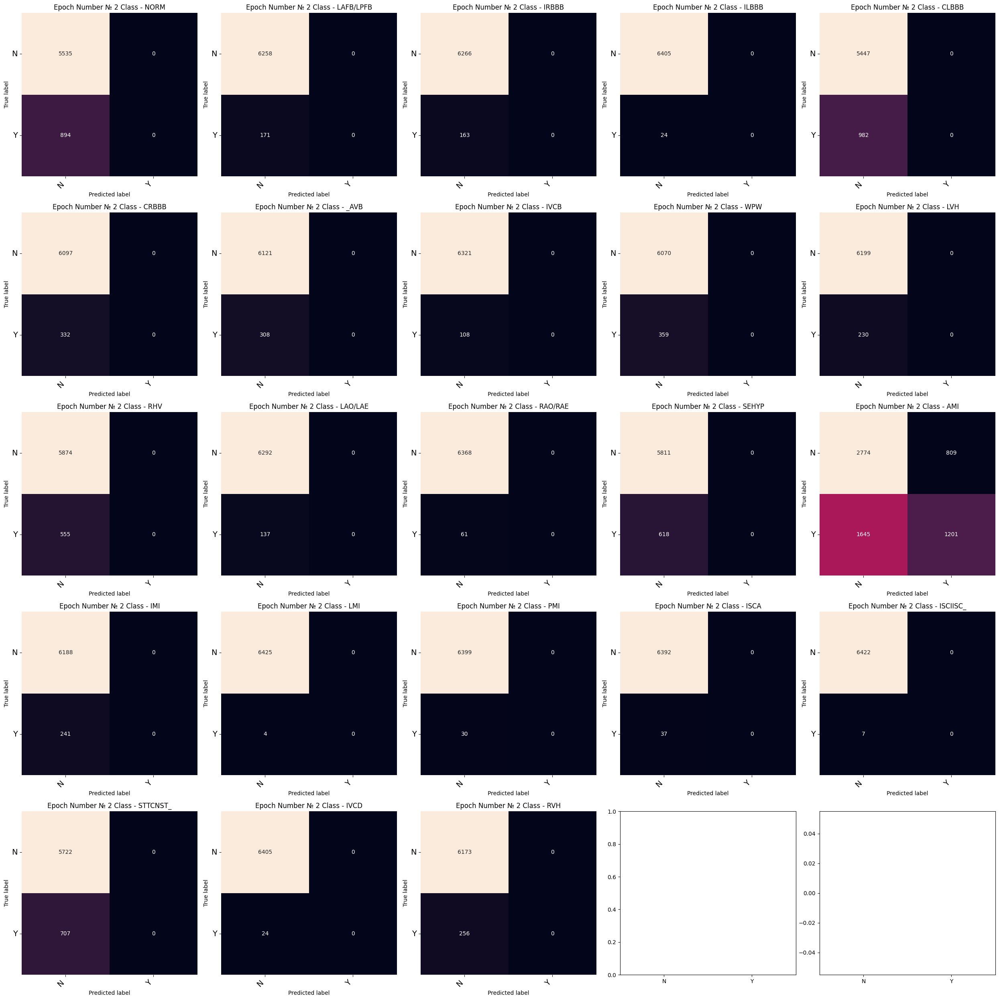

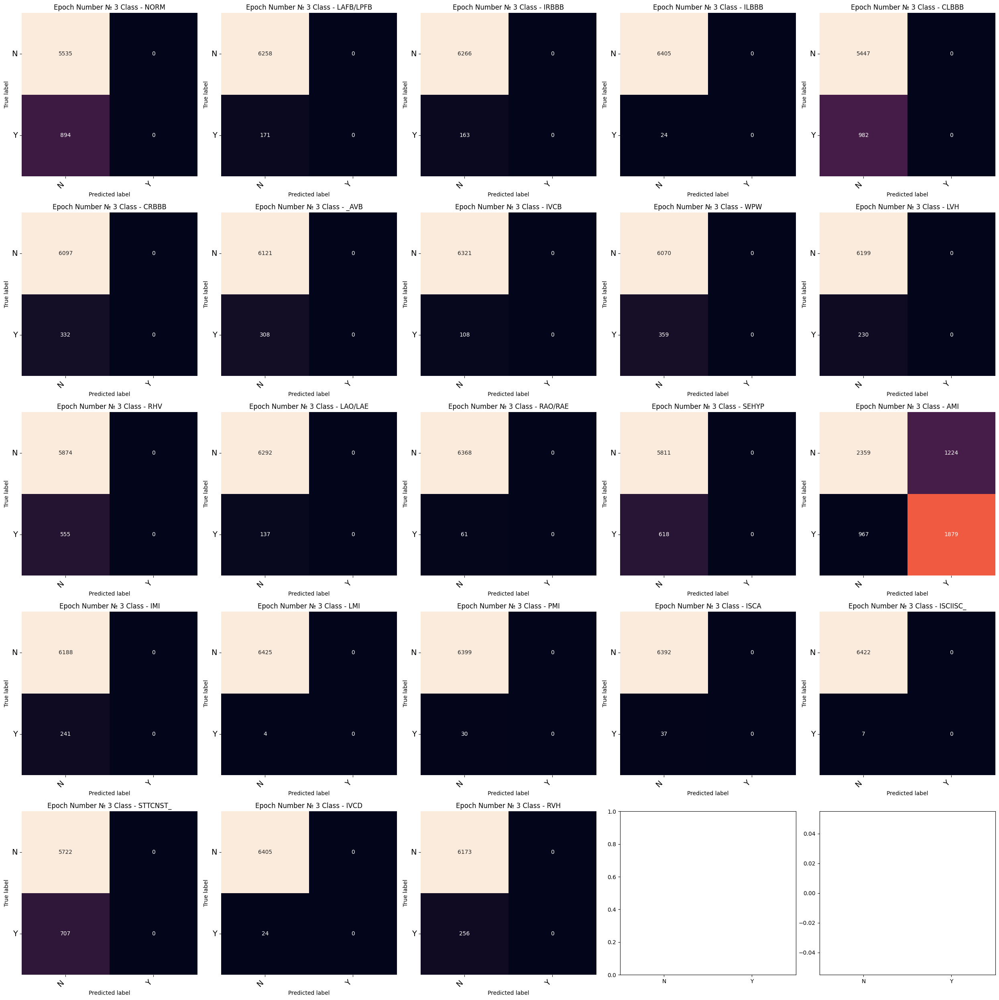

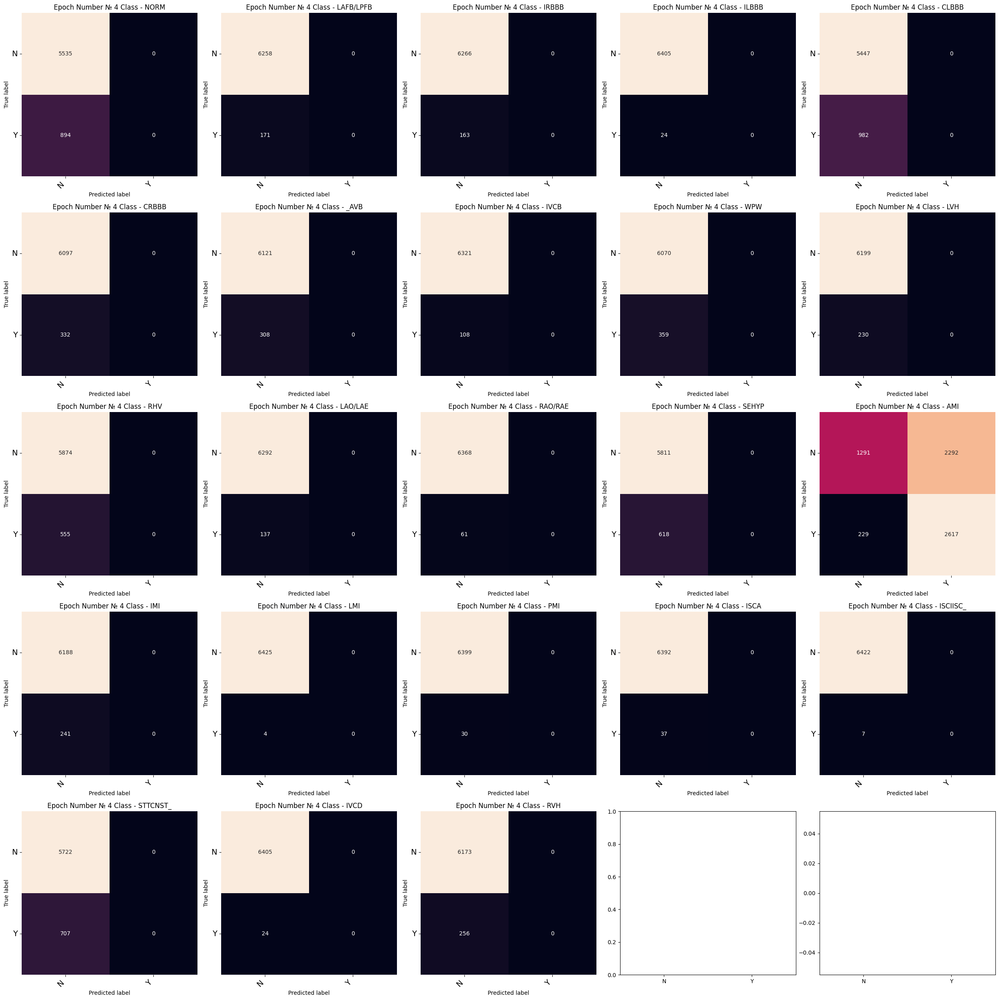

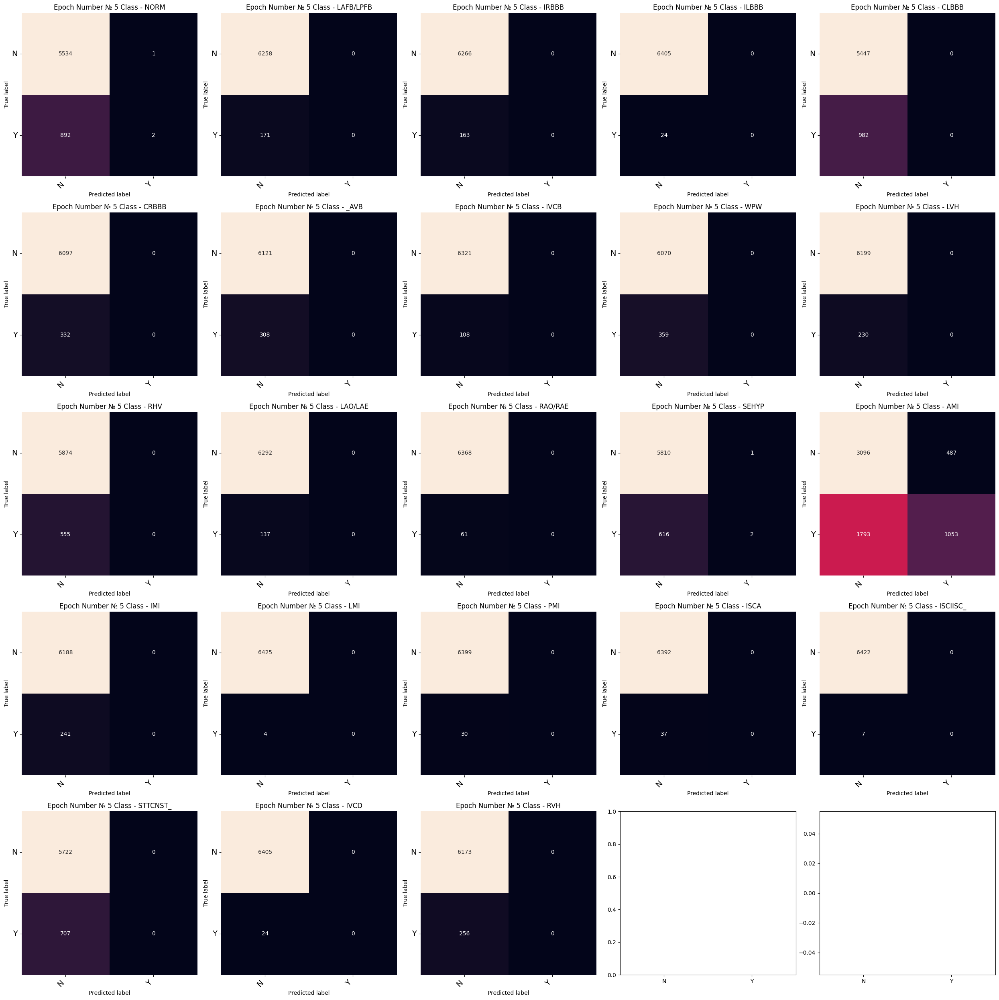

...

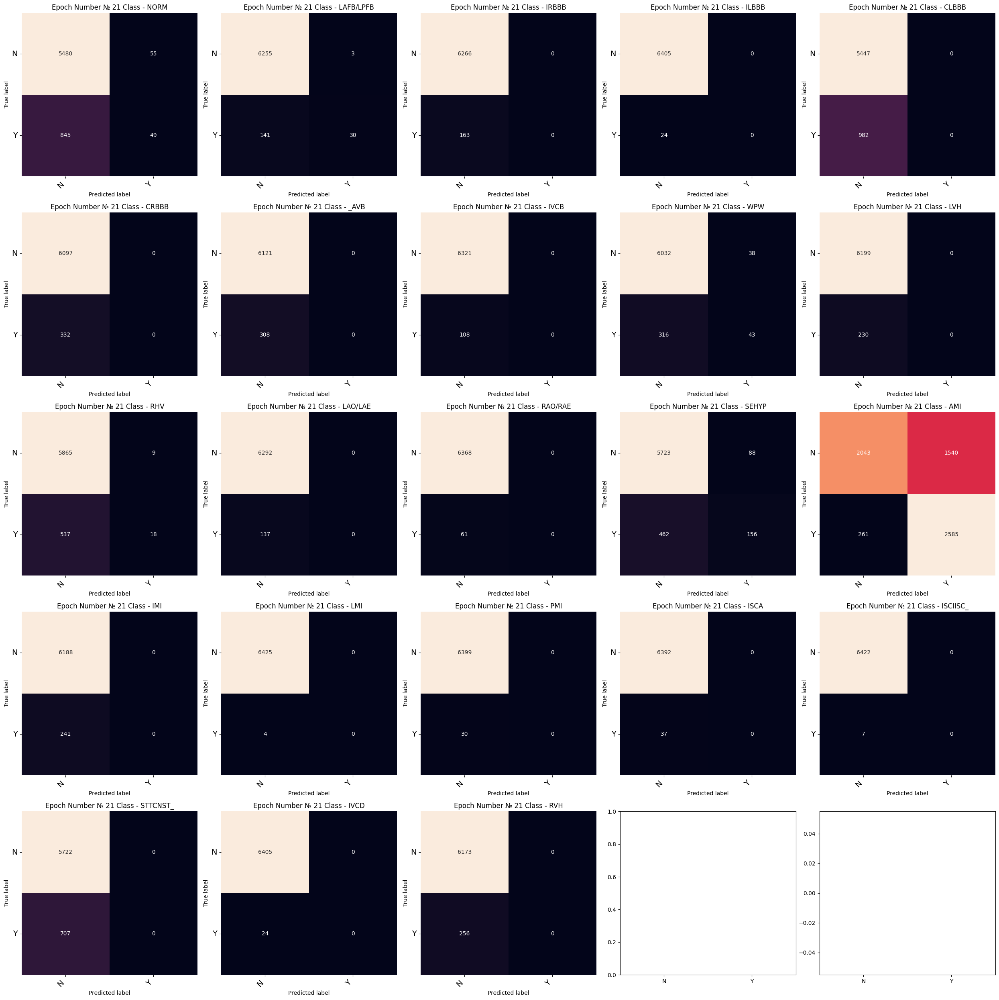

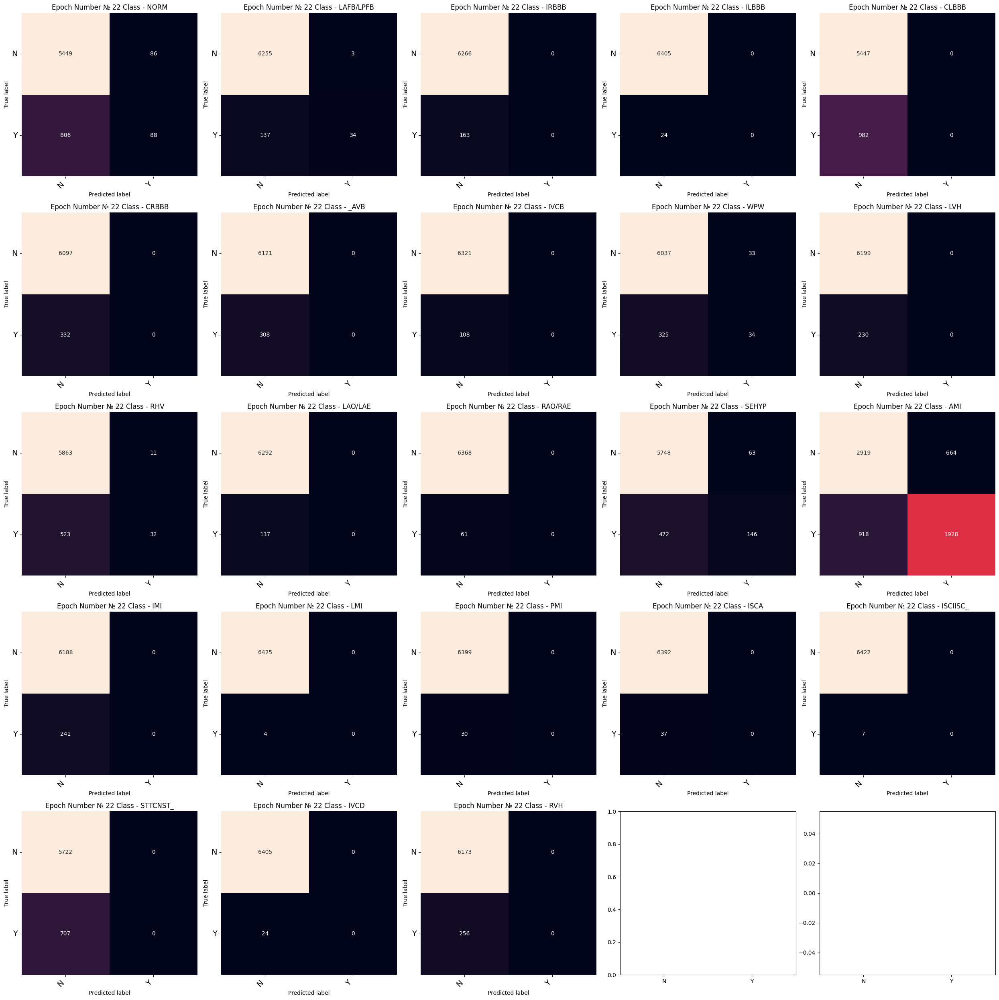

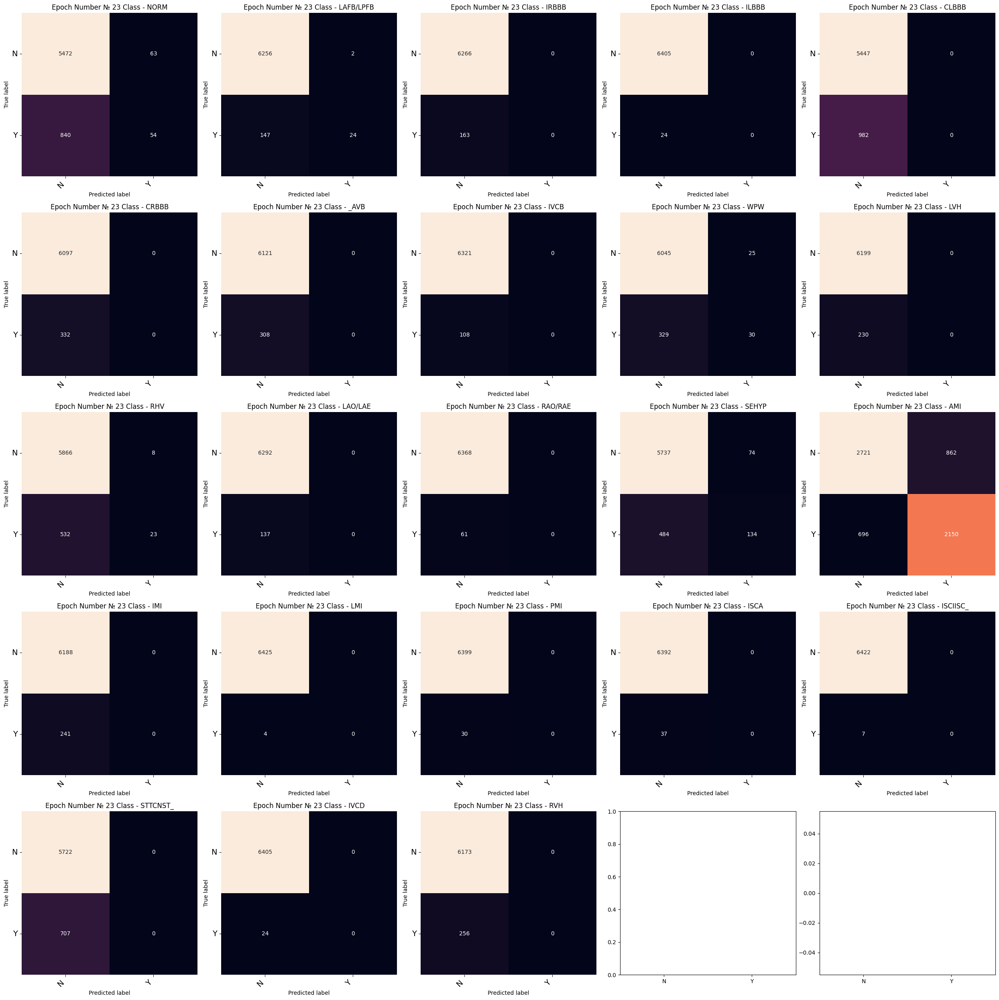

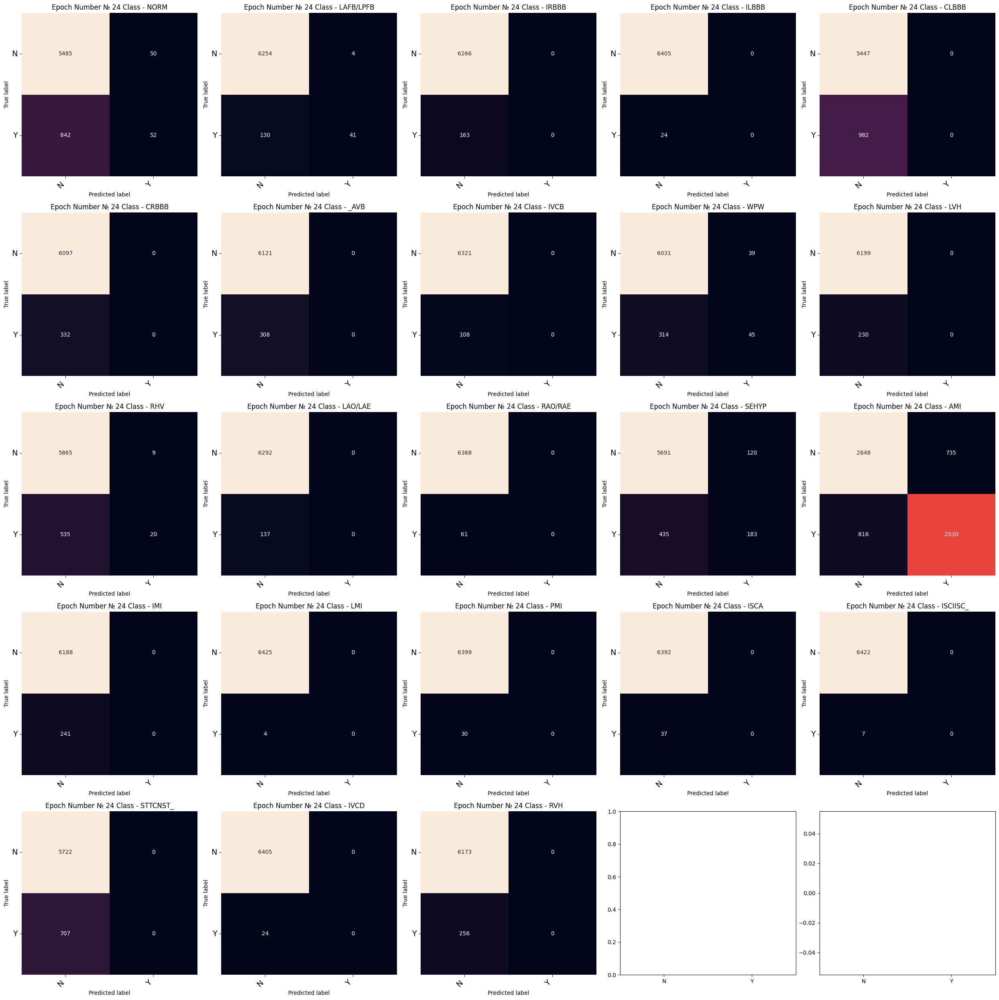

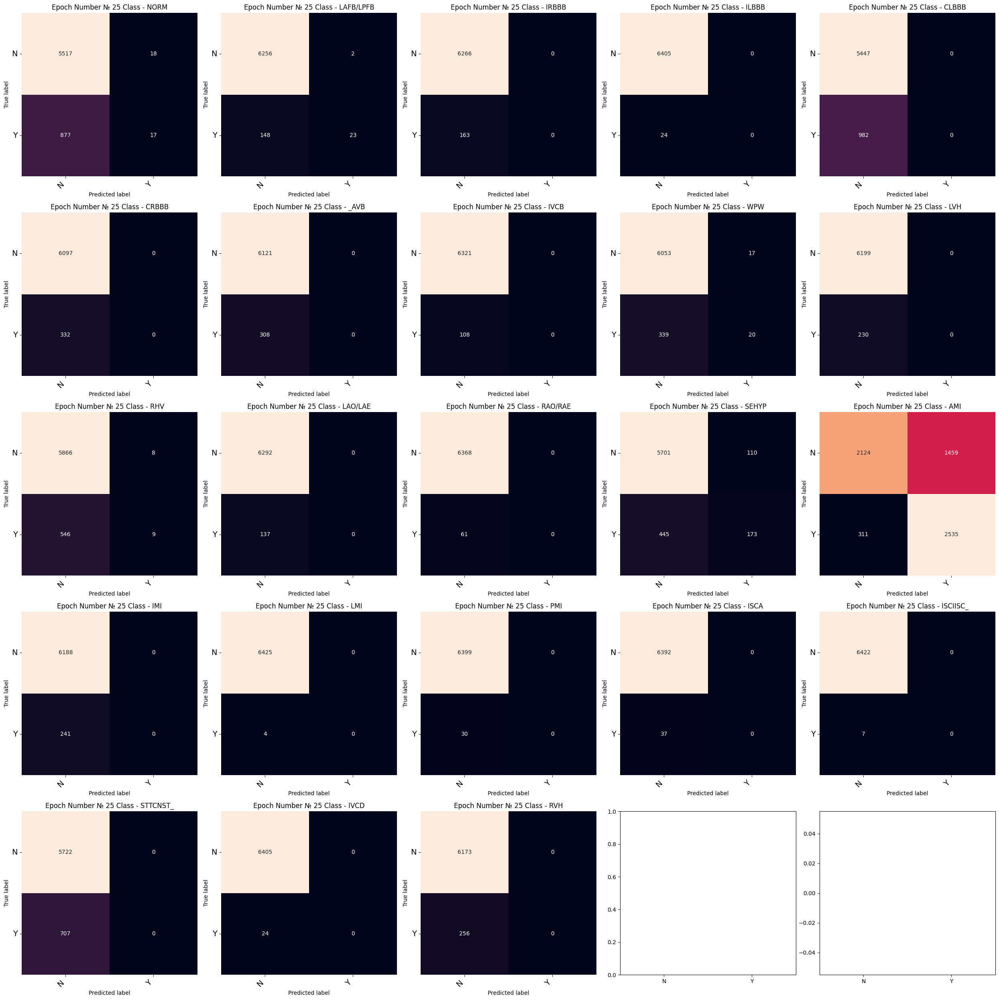

In [21]:
labels = ['NORM','LAFB/LPFB', 'IRBBB', 'ILBBB', 'CLBBB', 'CRBBB', '_AVB', 'IVCB', 'WPW', 'LVH', 'RHV', 'LAO/LAE', 'RAO/RAE', 'SEHYP', 'AMI', 'IMI', 'LMI', 'PMI','ISCA','ISCI''ISC_','STTC''NST_','IVCD','RVH']
index = 1
print(f"------------------CONFUSION MATRIX FOR EPOCHS ---------------------")
for cm in cm_arr:
    fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")
    for axes, cfs_matrix, label in zip(ax.flatten(), cm, labels):
        print_confusion_matrix(cfs_matrix, axes, label, ["N", "Y"], index)
    fig.tight_layout()
    plt.plot()
    index +=1

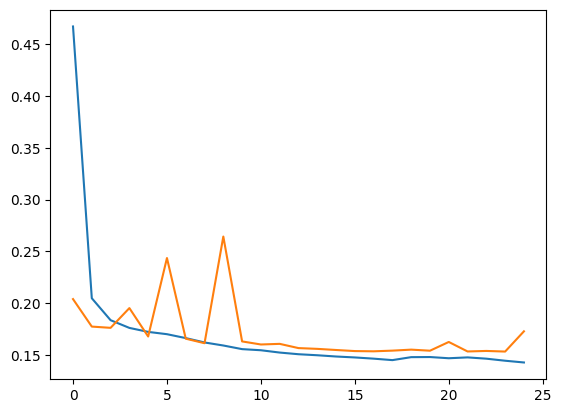

In [22]:
plt.plot(loss_train_th)
plt.plot(loss_test_th)
plt.show()

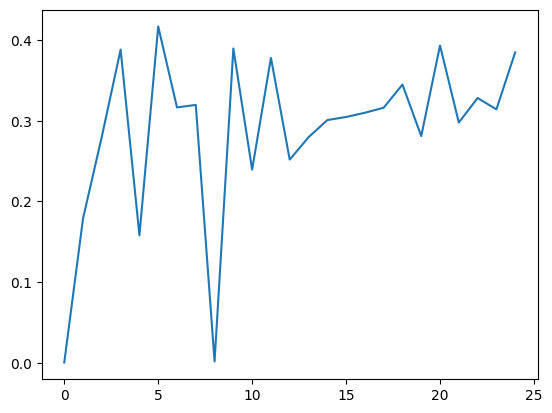

In [23]:
plt.plot(acc_th)
plt.show()

In [26]:
path_to_train='TrainSubClass/'
path_to_test='TestSubClass/'
X_train=np.load(path_to_train+"X_train.npy",allow_pickle=True)
Y_train=np.load(path_to_train+"Y_train.npy",allow_pickle=True)
X_test=np.load(path_to_test+"X_test.npy",allow_pickle=True)
Y_test=np.load(path_to_test+"Y_test.npy",allow_pickle=True)

In [27]:
from sklearn.metrics import confusion_matrix, accuracy_score
from torch.utils.data import TensorDataset, DataLoader

batch_size = 64
input_shape = X_train.shape[1]

X_train=X_train.reshape(X_train.shape[0],1,12000)
X_test=X_test.reshape(X_test.shape[0],1,12000)

X_train_tensor = torch.Tensor(X_train)
Y_train_tensor = torch.LongTensor(Y_train)

train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size = batch_size, shuffle = True)

X_test_tensor = torch.Tensor(X_test)
Y_test_tensor = torch.LongTensor(Y_test)

test_dataset = TensorDataset(X_test_tensor, Y_test_tensor)
test_loader = DataLoader(test_dataset, batch_size = batch_size, shuffle = True)

In [28]:
model3=nn.Sequential()
model3.add_module("conv1",nn.Conv1d(in_channels = 1, out_channels = 16, kernel_size = 101))
model3.add_module("relu1",nn.ReLU())
model3.add_module("conv2",nn.Conv1d(in_channels = 16, out_channels = 16, kernel_size = 215))
model3.add_module("relu2",nn.ReLU())
model3.add_module("flatten",nn.Flatten())
model3.add_module("dense1",nn.Linear((input_shape-101-215+2)*16,132))
model3.add_module("bn2",nn.BatchNorm1d(132))
model3.add_module("drop1", nn.Dropout(0.5))
model3.add_module("relu6",nn.ReLU())
model3.add_module("dense2",nn.Linear(132,132))
model3.add_module("drop2", nn.Dropout(0.5))
model3.add_module("relu7",nn.ReLU())
model3.add_module("dense3", nn.Linear(132,23))
model3.add_module("softmax",nn.Sigmoid())

loss_function=nn.BCELoss()
optimizer = torch.optim.Adam(model3.parameters(), lr=0.0001)

In [29]:
loss_train_4=[]
loss_test_4=[]
acc_4=[]
cm_arr = []
for epoch in range(25):
    loss_train_4.append(train(epoch + 1,model3))
    acc_,test_loss_=test(model3)
    acc_4.append(acc_)
    loss_test_th.append(test_loss_)
    cm_arr.append(calc_confusion_matrix(model3, X_test_tensor, Y_test_tensor))

Train Epoch: 1 [0/15001 (0%)]	Loss: 0.703646
Train Epoch: 1 [6400/15001 (43%)]	Loss: 0.443764
Train Epoch: 1 [12800/15001 (85%)]	Loss: 0.239417
Accurancy 29.07%

Train Epoch: 2 [0/15001 (0%)]	Loss: 0.194778
Train Epoch: 2 [6400/15001 (43%)]	Loss: 0.190131
Train Epoch: 2 [12800/15001 (85%)]	Loss: 0.163435
Accurancy 39.40%

Train Epoch: 3 [0/15001 (0%)]	Loss: 0.162020
Train Epoch: 3 [6400/15001 (43%)]	Loss: 0.151021
Train Epoch: 3 [12800/15001 (85%)]	Loss: 0.159148
Accurancy 35.06%

Train Epoch: 4 [0/15001 (0%)]	Loss: 0.122477
Train Epoch: 4 [6400/15001 (43%)]	Loss: 0.170127
Train Epoch: 4 [12800/15001 (85%)]	Loss: 0.168876
Accurancy 34.14%

Train Epoch: 5 [0/15001 (0%)]	Loss: 0.162548
Train Epoch: 5 [6400/15001 (43%)]	Loss: 0.131198
Train Epoch: 5 [12800/15001 (85%)]	Loss: 0.128595
Accurancy 42.48%

Train Epoch: 6 [0/15001 (0%)]	Loss: 0.105956
Train Epoch: 6 [6400/15001 (43%)]	Loss: 0.111504
Train Epoch: 6 [12800/15001 (85%)]	Loss: 0.098329
Accurancy 42.73%

Train Epoch: 7 [0/15001 (0%)

------------------CONFUSION MATRIX FOR EPOCHS ---------------------


C:\Users\micro\AppData\Local\Temp\ipykernel_820\1505892843.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")


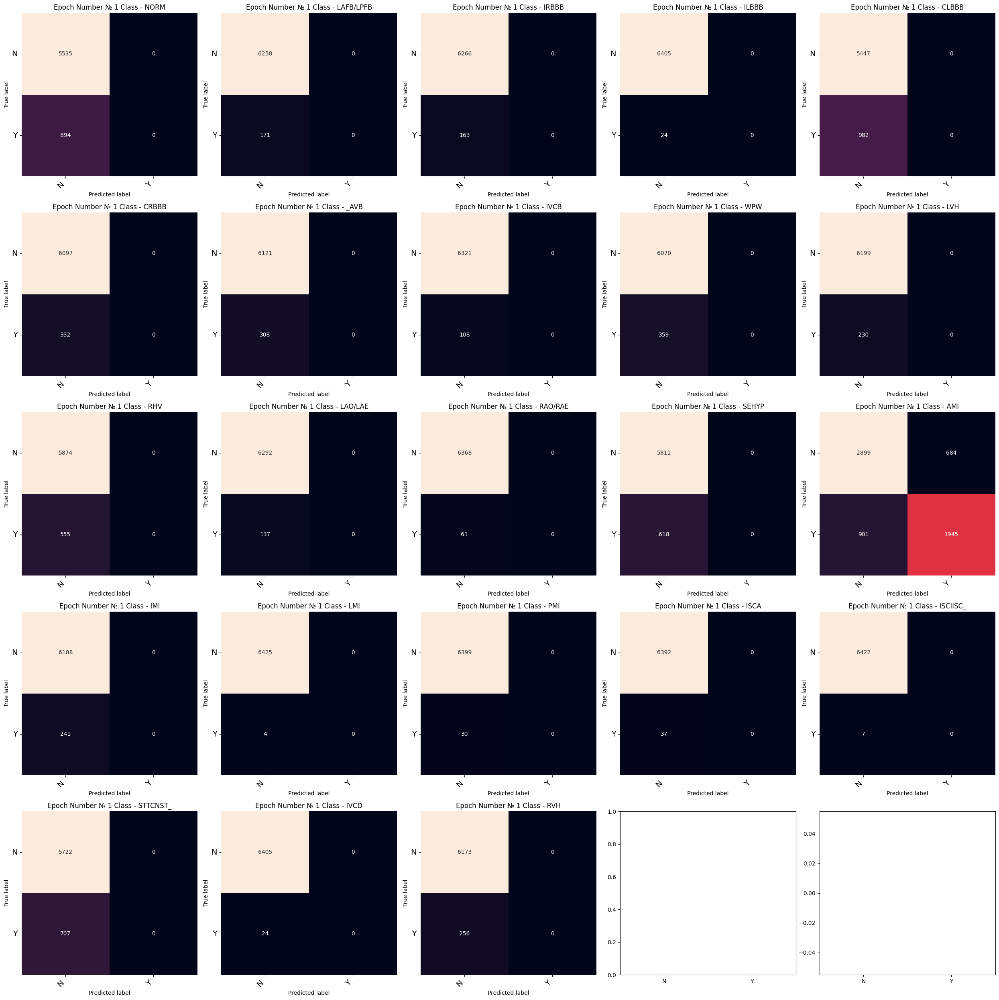

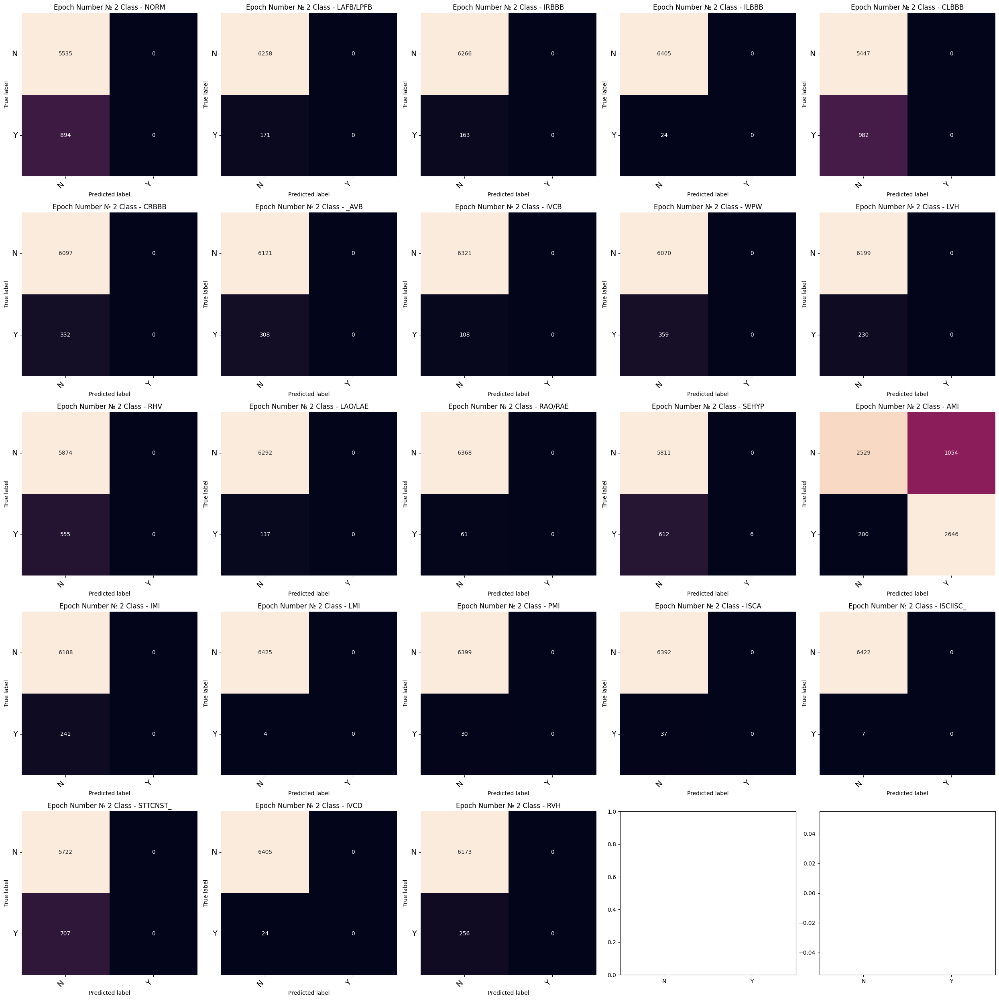

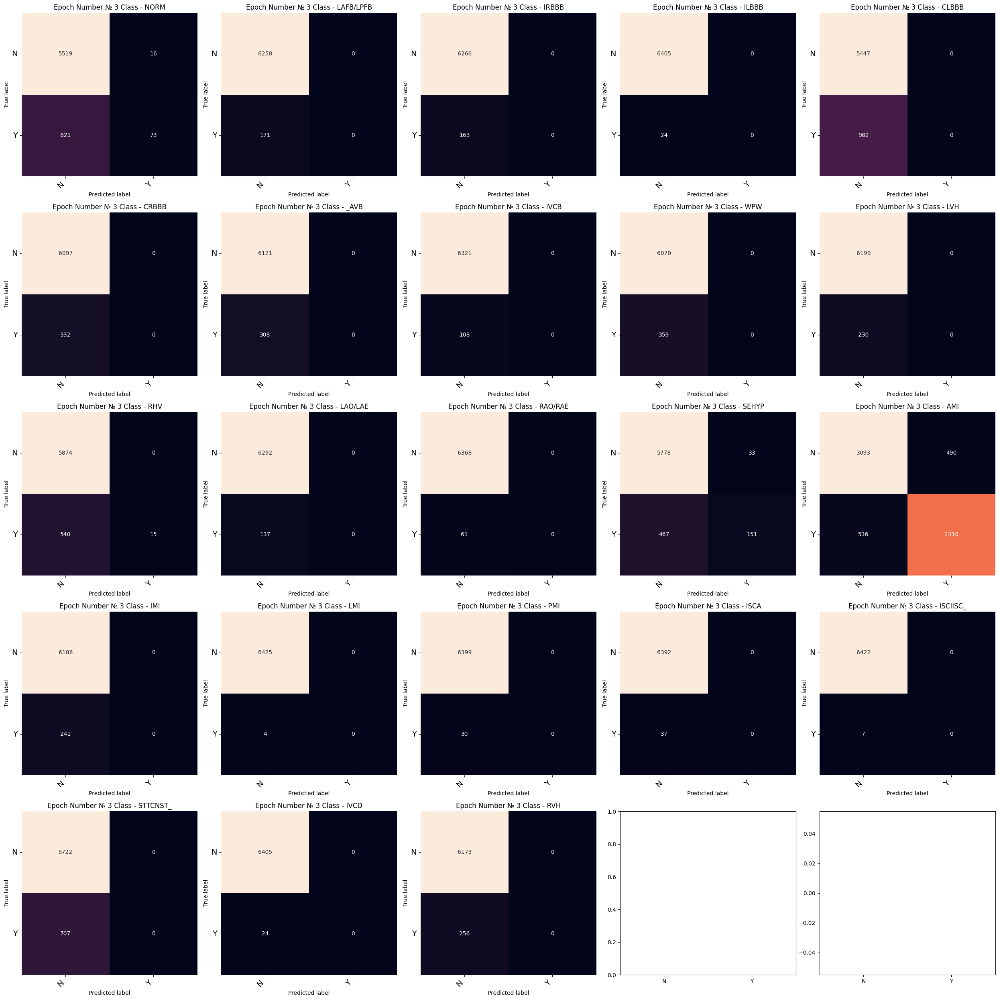

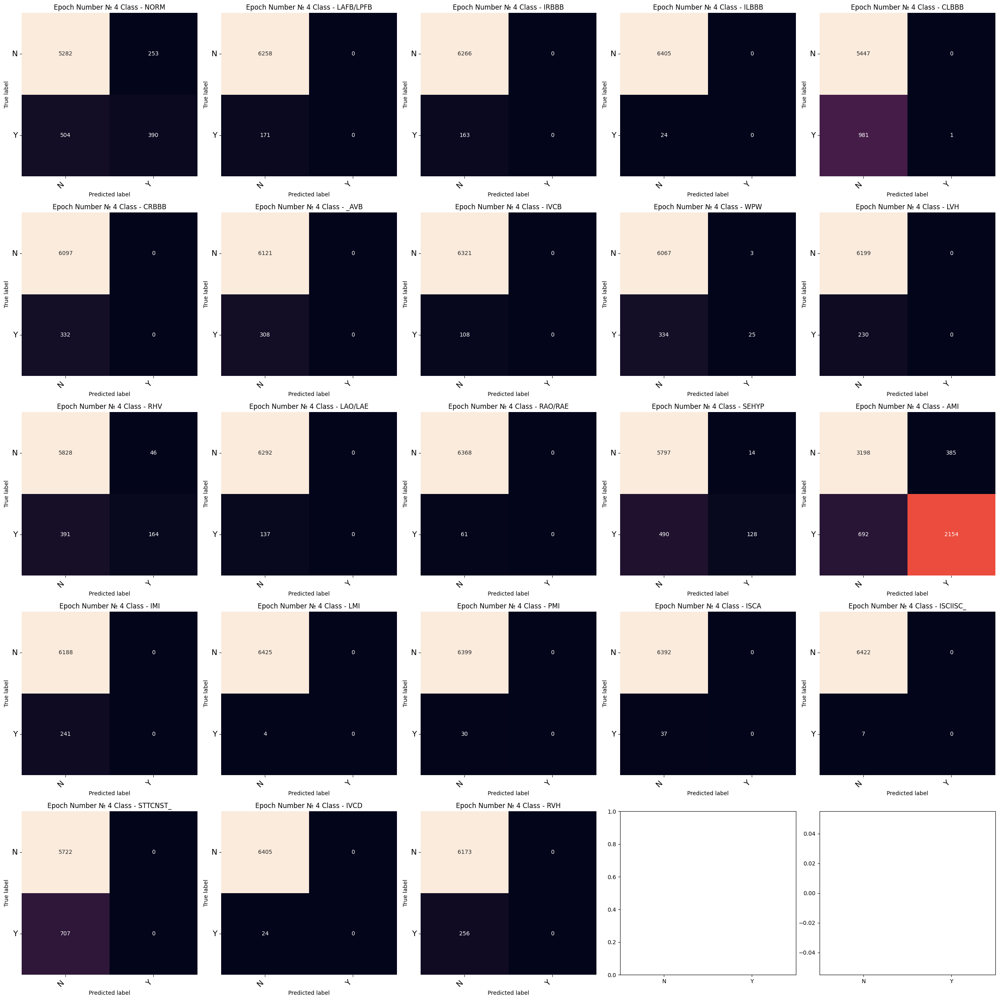

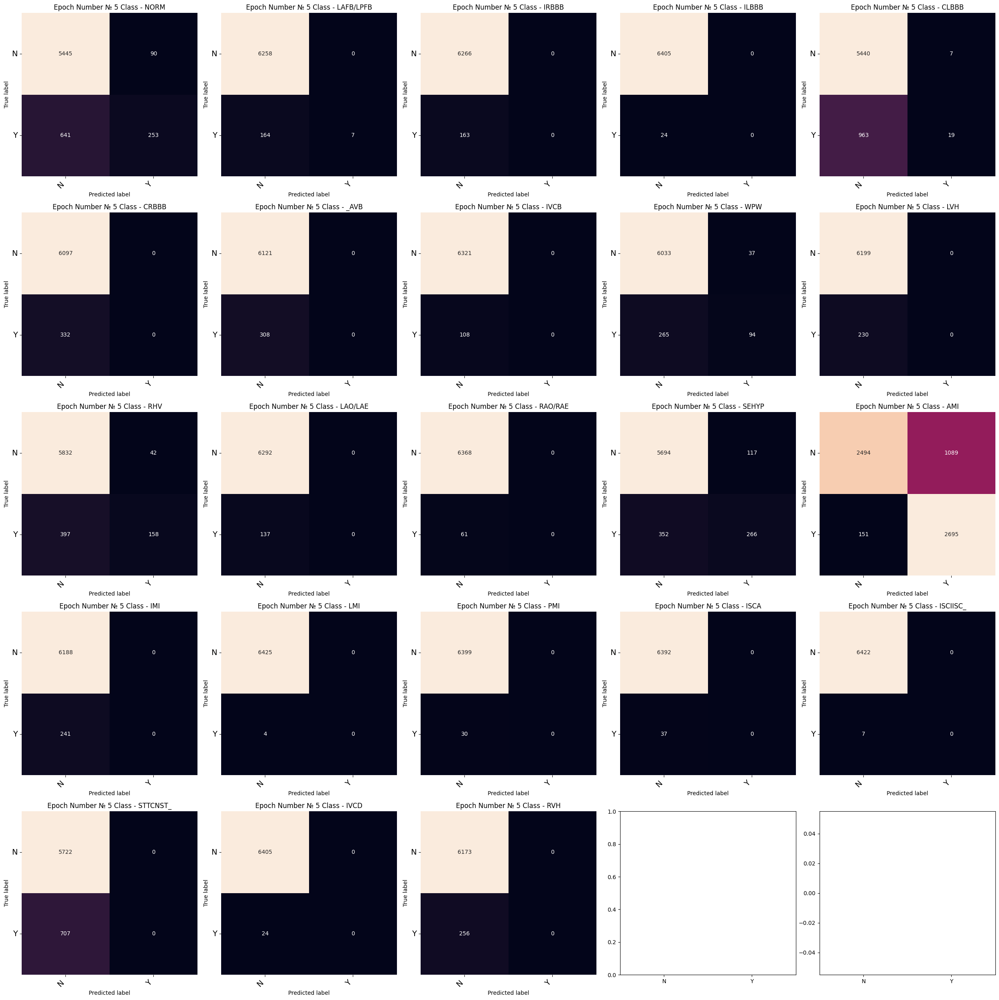

...

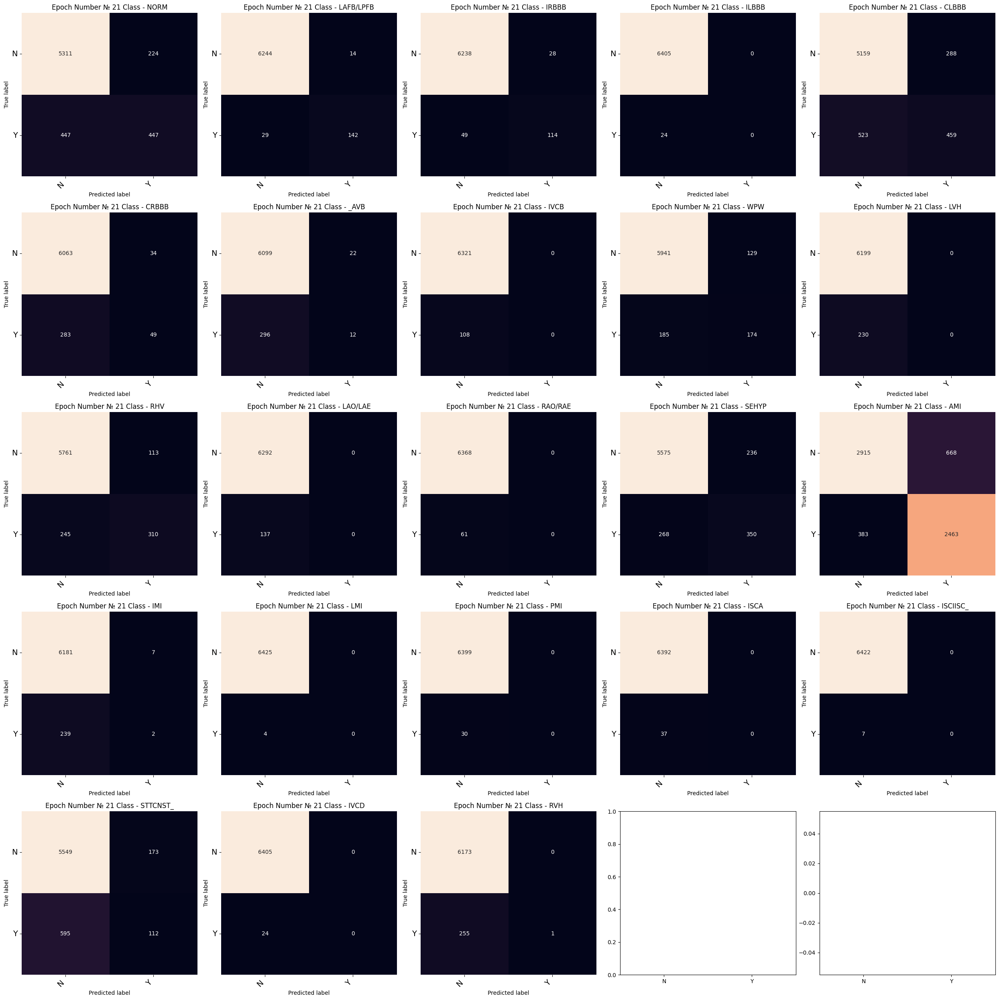

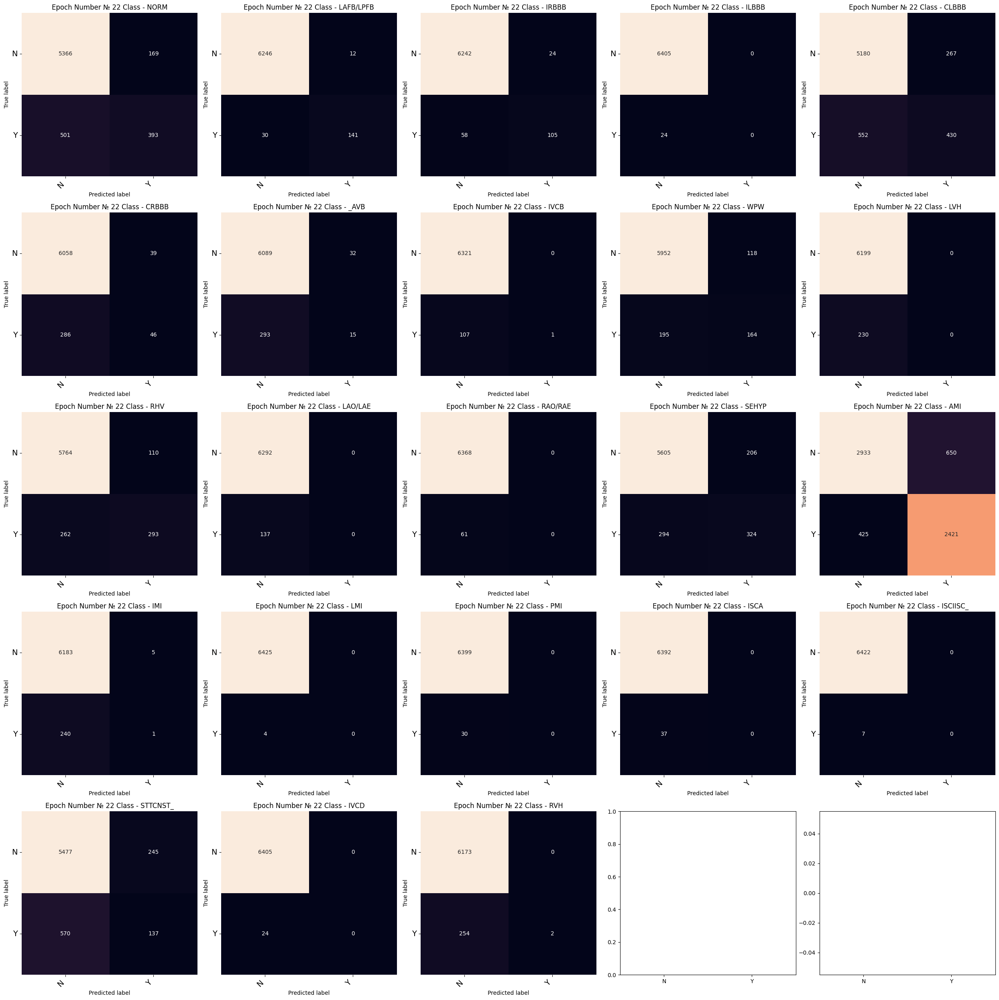

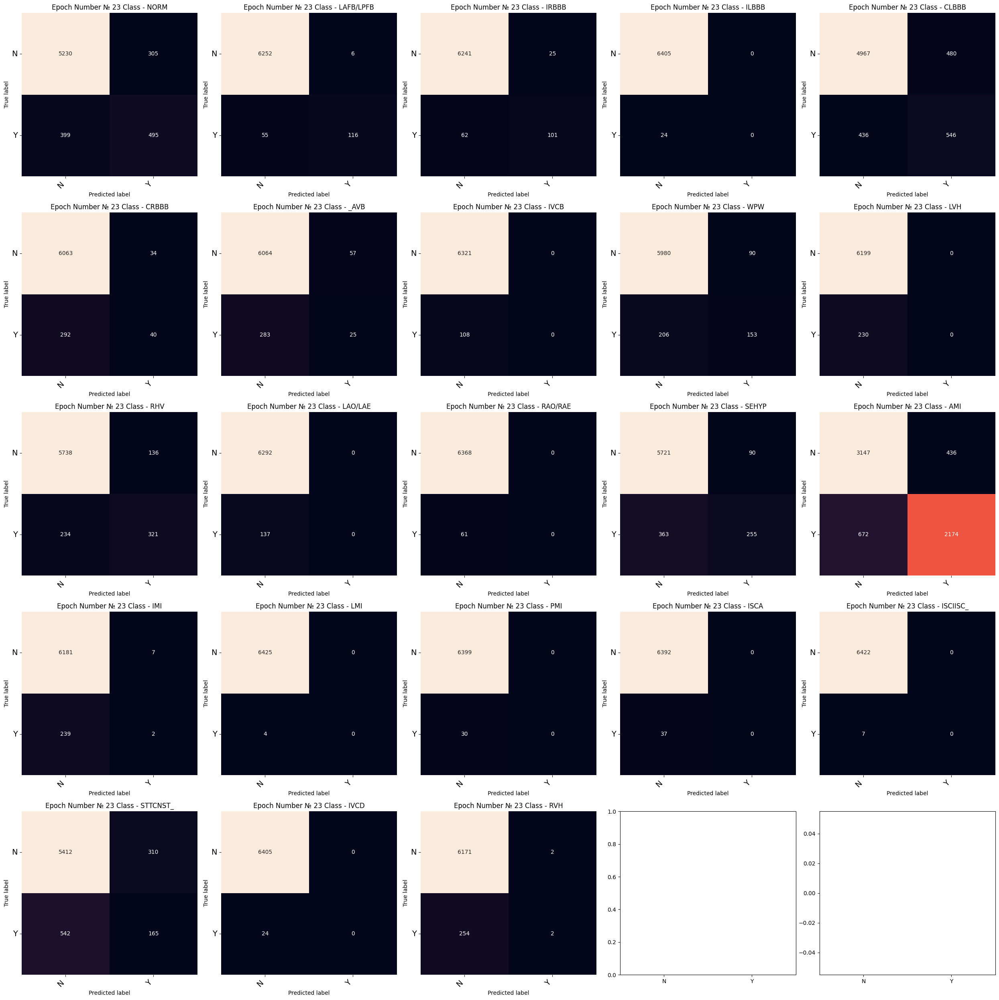

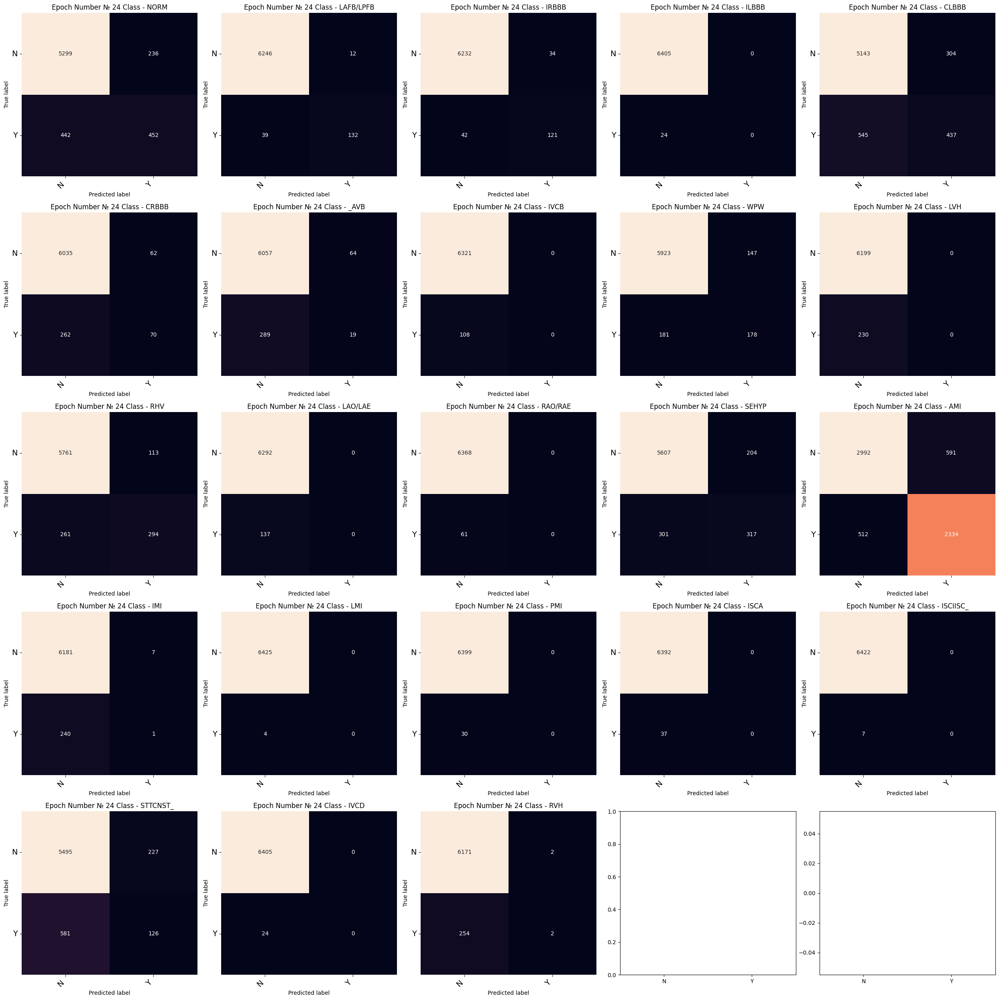

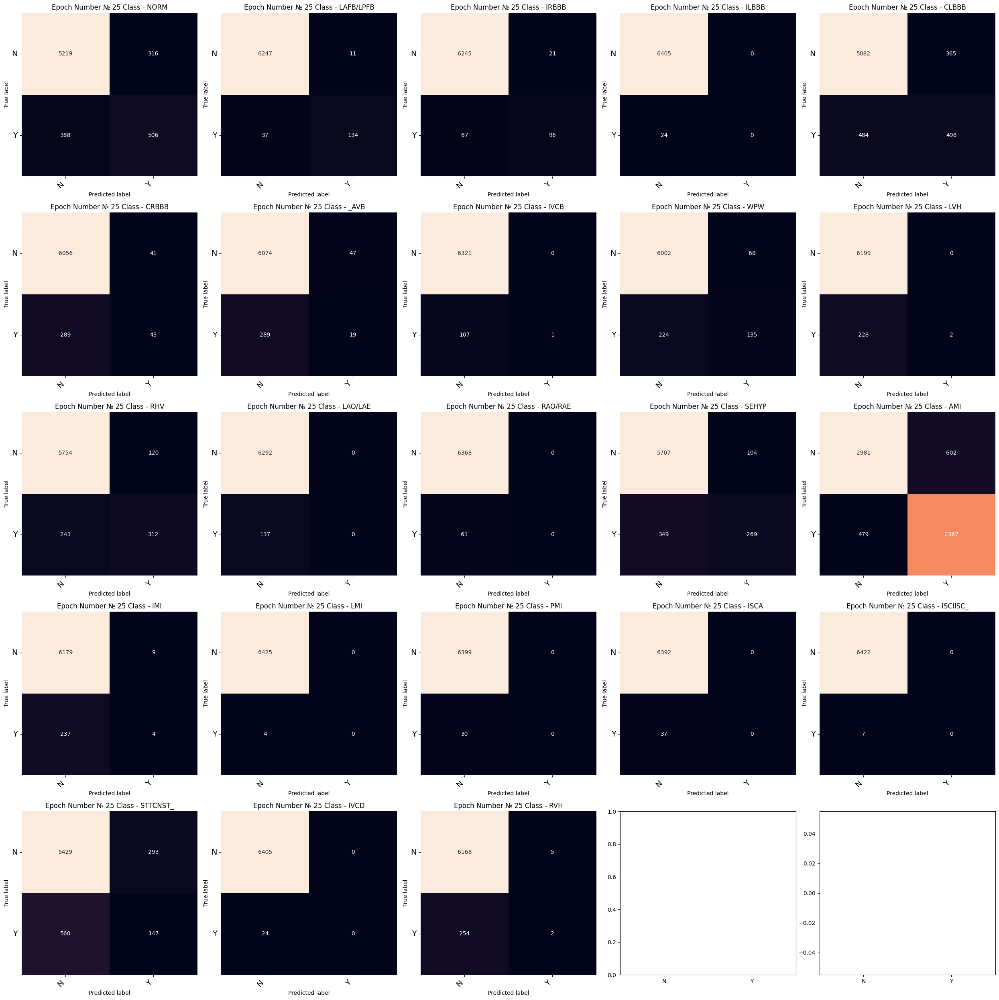

In [30]:
labels = ['NORM','LAFB/LPFB', 'IRBBB', 'ILBBB', 'CLBBB', 'CRBBB', '_AVB', 'IVCB', 'WPW', 'LVH', 'RHV', 'LAO/LAE', 'RAO/RAE', 'SEHYP', 'AMI', 'IMI', 'LMI', 'PMI','ISCA','ISCI''ISC_','STTC''NST_','IVCD','RVH']
index = 1
print(f"------------------CONFUSION MATRIX FOR EPOCHS ---------------------")
for cm in cm_arr:
    fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")
    for axes, cfs_matrix, label in zip(ax.flatten(), cm, labels):
        print_confusion_matrix(cfs_matrix, axes, label, ["N", "Y"], index)
    fig.tight_layout()
    plt.plot()
    index +=1

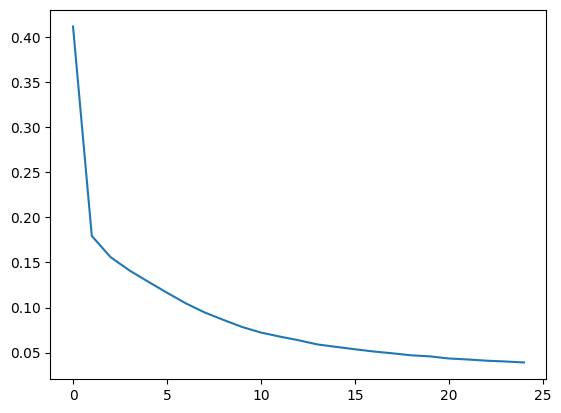

In [39]:
plt.plot(loss_train_4)
plt.plot(loss_test_4)
plt.show()

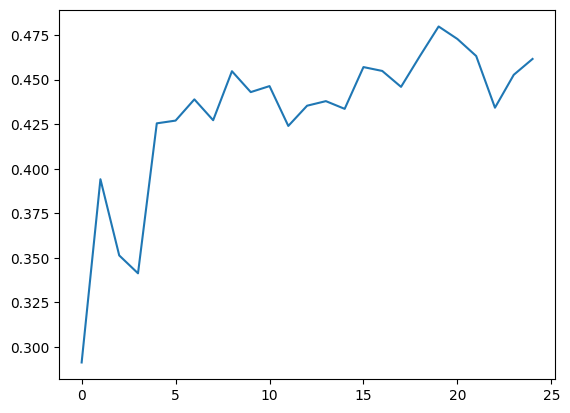

In [32]:
plt.plot(acc_4)
plt.show()

In [33]:
path_to_train='TrainSubClass/'
path_to_test='TestSubClass/'
X_train=np.load(path_to_train+"X_train.npy",allow_pickle=True)
Y_train=np.load(path_to_train+"Y_train.npy",allow_pickle=True)
X_test=np.load(path_to_test+"X_test.npy",allow_pickle=True)
Y_test=np.load(path_to_test+"Y_test.npy",allow_pickle=True)

In [119]:
from sklearn.metrics import confusion_matrix, accuracy_score
from torch.utils.data import TensorDataset, DataLoader

batch_size = 64
input_shape = X_train.shape[1]

X_train=X_train.reshape(X_train.shape[0],1,12000)
X_test=X_test.reshape(X_test.shape[0],1,12000)

X_train_tensor = torch.Tensor(X_train)
Y_train_tensor = torch.LongTensor(Y_train)

train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size = batch_size, shuffle = True)

X_test_tensor = torch.Tensor(X_test)
Y_test_tensor = torch.LongTensor(Y_test)

test_dataset = TensorDataset(X_test_tensor, Y_test_tensor)
test_loader = DataLoader(test_dataset, batch_size = batch_size, shuffle = True)

In [122]:
from torch.autograd import Variable 
model4 = nn.Sequential()

class myLSTM(nn.Module): 
    def __init__(self, num_classes, input_size, hidden_size, num_layers):
        super(myLSTM, self).__init__()
        self.num_classes = num_classes
        self.num_layers = num_layers 
        self.input_size = input_size 
        self.hidden_size = hidden_size 

        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size,
                          num_layers=num_layers, batch_first=True)
        self.fc_1 =  nn.Linear(128, 128) 
        self.fc = nn.Linear(128, num_classes) 
        self.relu = nn.ReLU()
        self.flatten = nn.Flatten()
        self.gap = nn.AvgPool1d(num_layers)
    
    def forward(self, x): 
        h_0 = Variable(torch.zeros(self.num_layers, x.size(0), self.hidden_size))
        c_0 = Variable(torch.zeros(self.num_layers, x.size(0), self.hidden_size))
        
        output, (hn, cn) = self.lstm(x, (h_0, c_0)) 
        hn = hn.view(x.size(0), -1, self.hidden_size) 
        out = self.flatten(hn)
        out = self.gap(out)
        out = self.relu(out)
        out = self.fc_1(out)
        out = self.relu(out)
        out = self.fc(out) 
        return out

model4.add_module('LSTM', myLSTM(23,input_shape,128,2))
model4.add_module("softmax",nn.Sigmoid())

loss_function=loss_function=nn.BCELoss()
optimizer = torch.optim.Adam(model4.parameters(), lr=0.0001)

In [123]:
loss_train_4=[]
loss_test_4=[]
acc_4=[]
cm_arr = []
for epoch in range(25):
    loss_train_4.append(train(epoch + 1,model4))
    acc_,test_loss_=test(model4)
    acc_4.append(acc_)
    loss_test_4.append(test_loss_)
    cm_arr.append(calc_confusion_matrix(model4, X_test_tensor, Y_test_tensor))

Train Epoch: 1 [0/19267 (0%)]	Loss: 0.705172
Train Epoch: 1 [6400/19267 (33%)]	Loss: 0.659462
Train Epoch: 1 [12800/19267 (66%)]	Loss: 0.398292
Train Epoch: 1 [19200/19267 (99%)]	Loss: 0.237510
Accurancy 0.00%

Train Epoch: 2 [0/19267 (0%)]	Loss: 0.222882
Train Epoch: 2 [6400/19267 (33%)]	Loss: 0.201627
Train Epoch: 2 [12800/19267 (66%)]	Loss: 0.202813
Train Epoch: 2 [19200/19267 (99%)]	Loss: 0.192840
Accurancy 0.00%

Train Epoch: 3 [0/19267 (0%)]	Loss: 0.180597
Train Epoch: 3 [6400/19267 (33%)]	Loss: 0.200126
Train Epoch: 3 [12800/19267 (66%)]	Loss: 0.198325
Train Epoch: 3 [19200/19267 (99%)]	Loss: 0.185777
Accurancy 0.00%

Train Epoch: 4 [0/19267 (0%)]	Loss: 0.216040
Train Epoch: 4 [6400/19267 (33%)]	Loss: 0.209938
Train Epoch: 4 [12800/19267 (66%)]	Loss: 0.200829
Train Epoch: 4 [19200/19267 (99%)]	Loss: 0.168924
Accurancy 0.00%

Train Epoch: 5 [0/19267 (0%)]	Loss: 0.183760
Train Epoch: 5 [6400/19267 (33%)]	Loss: 0.181809
Train Epoch: 5 [12800/19267 (66%)]	Loss: 0.213662
Train Epoch:

------------------CONFUSION MATRIX FOR EPOCHS ---------------------


C:\Users\micro\AppData\Local\Temp\ipykernel_21292\1505892843.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")


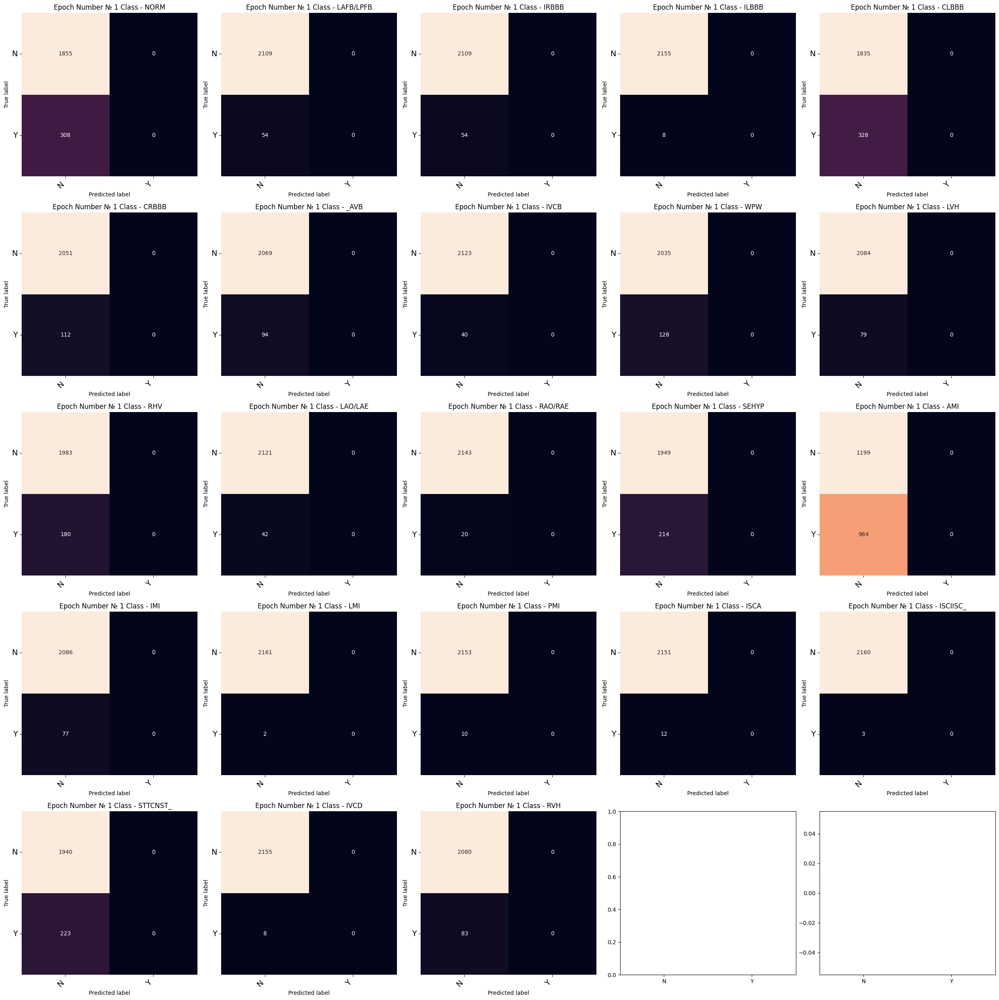

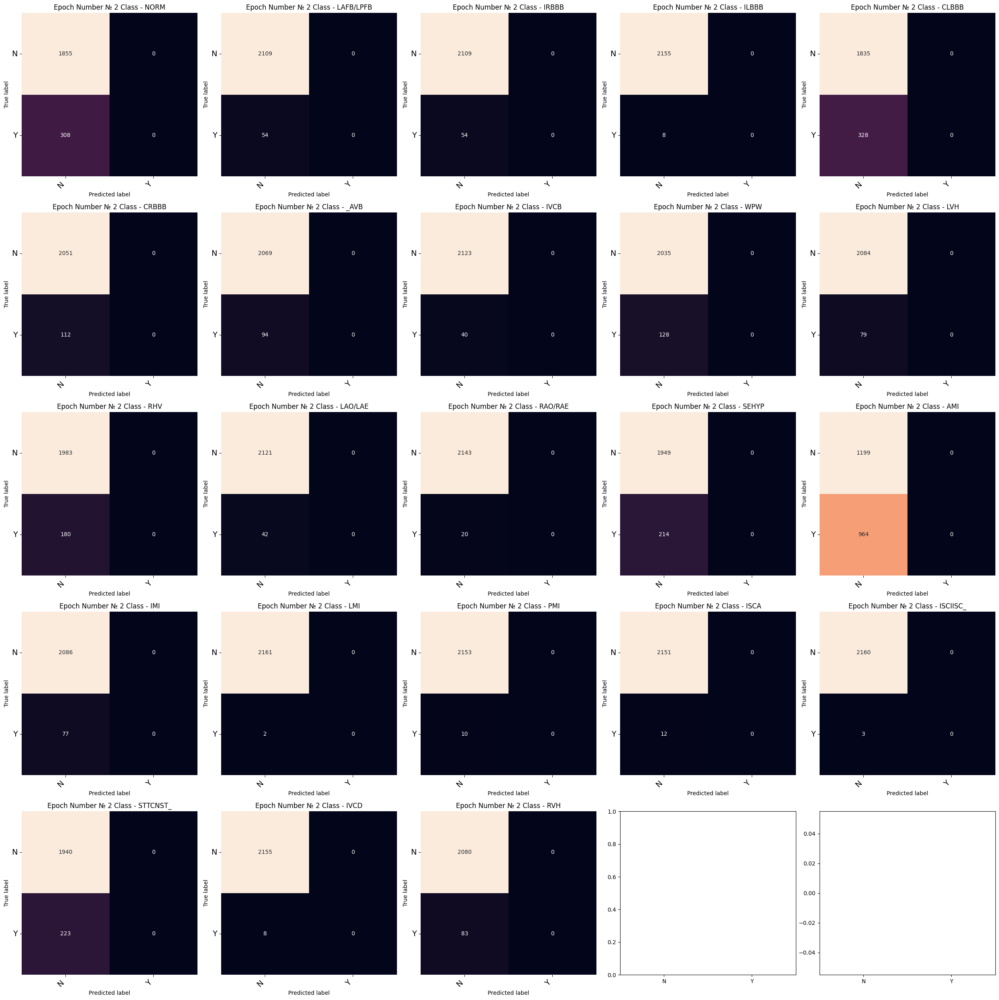

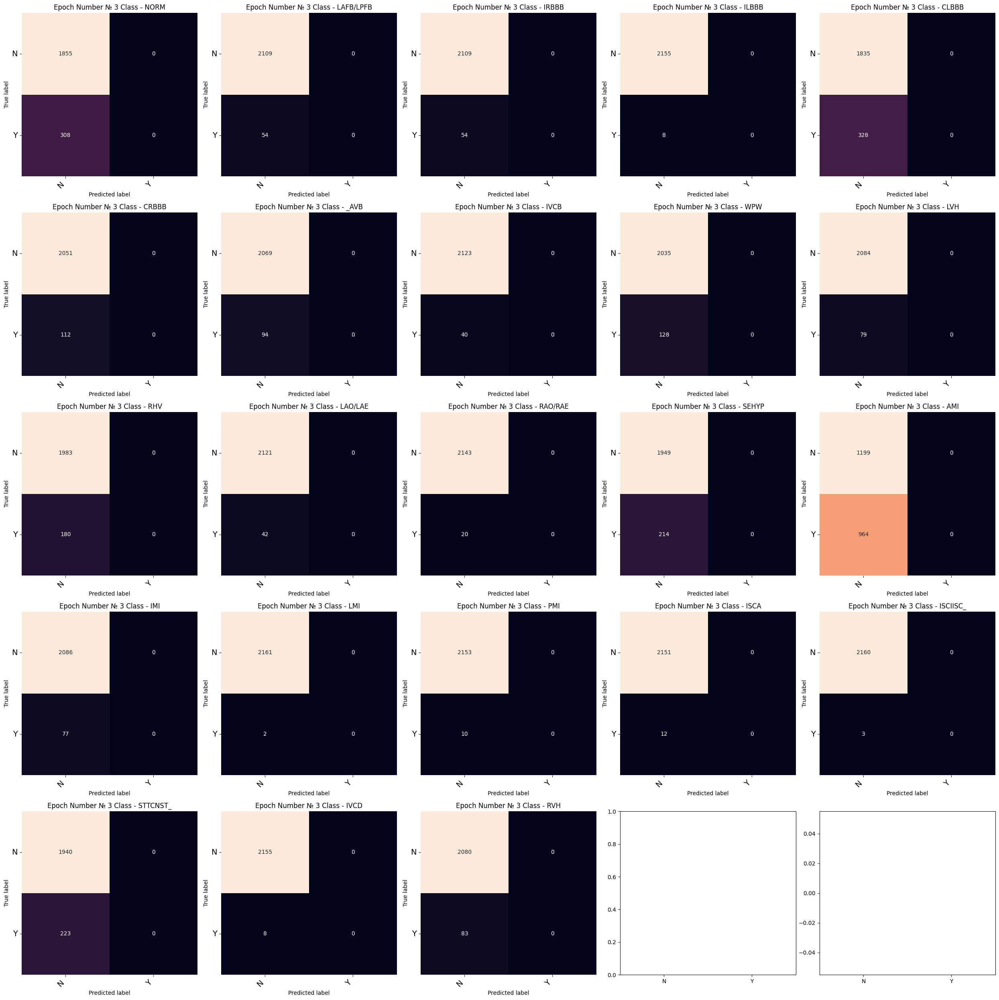

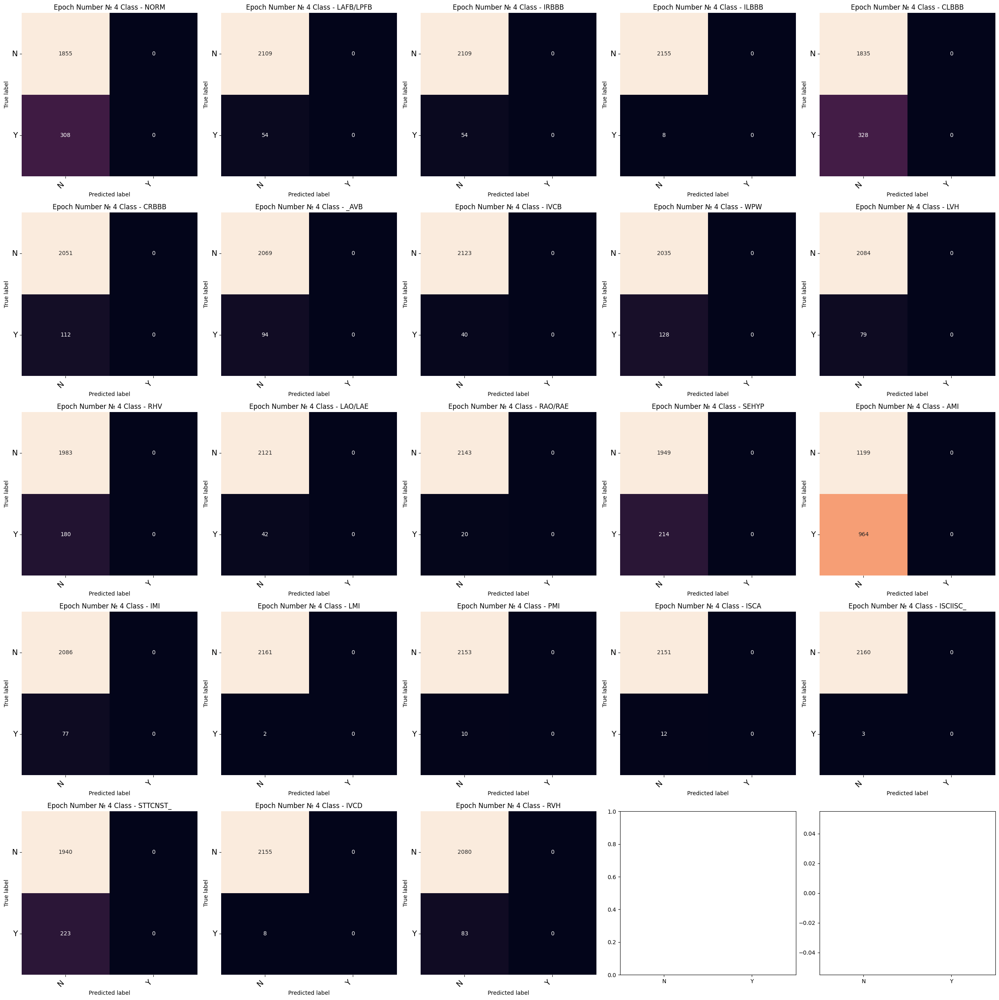

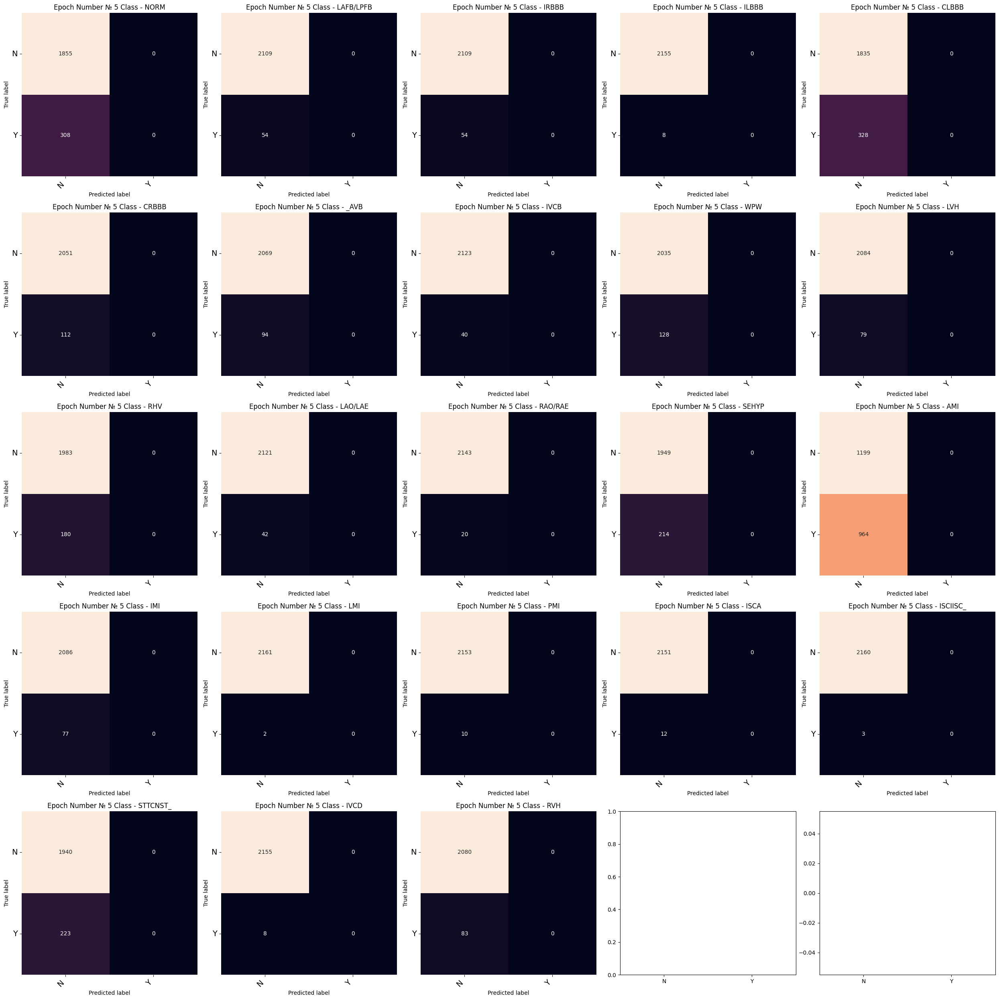

...

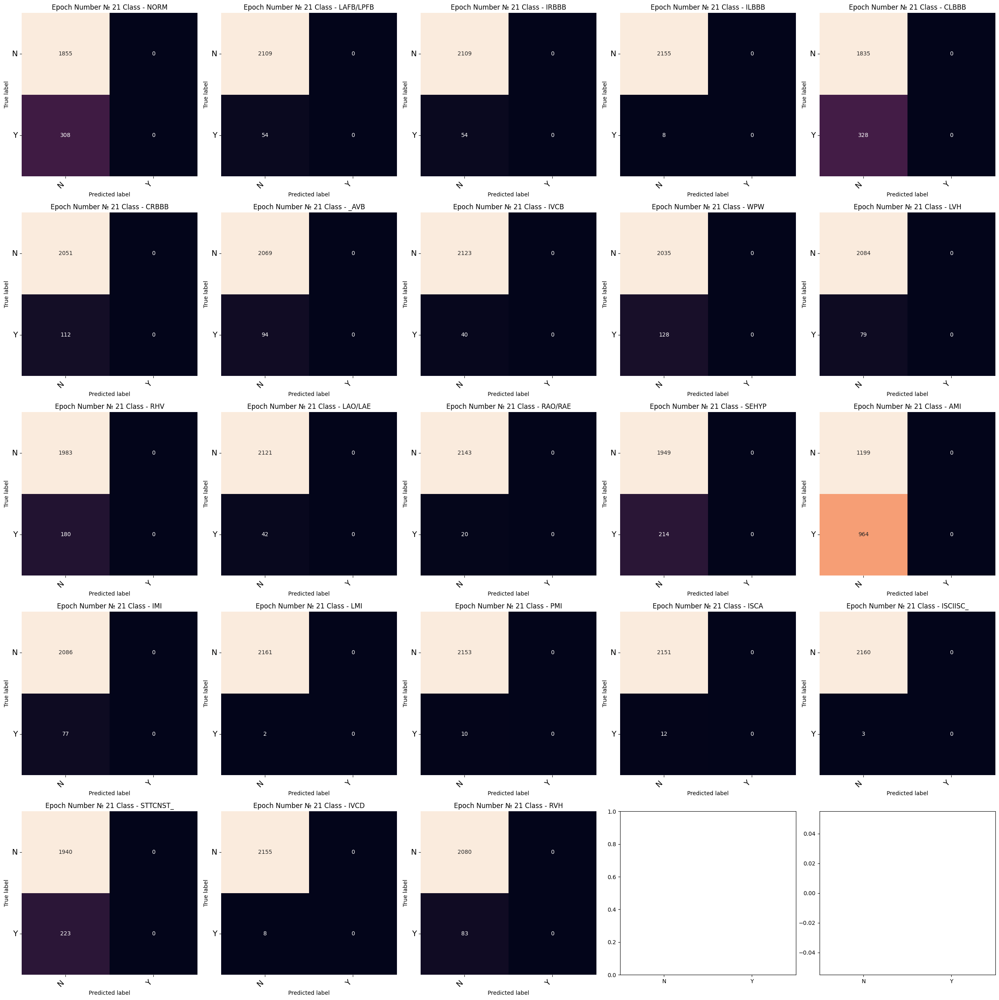

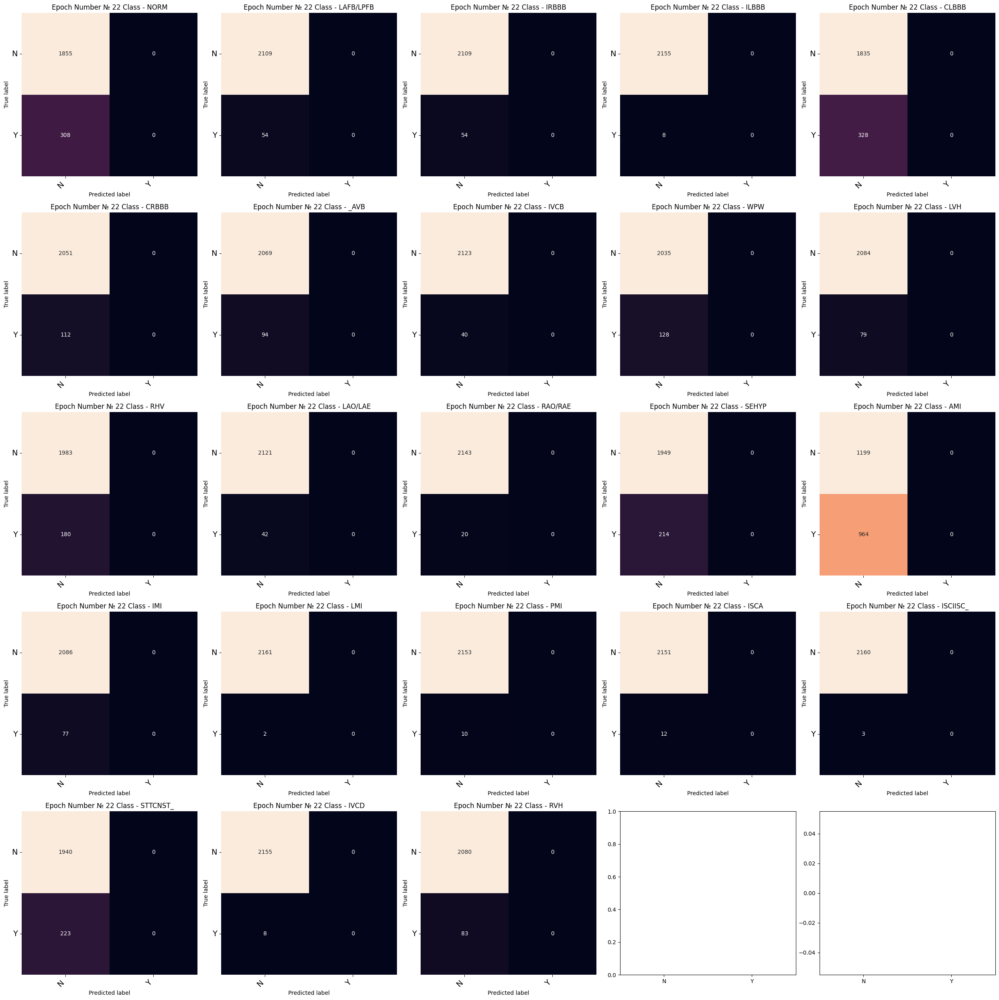

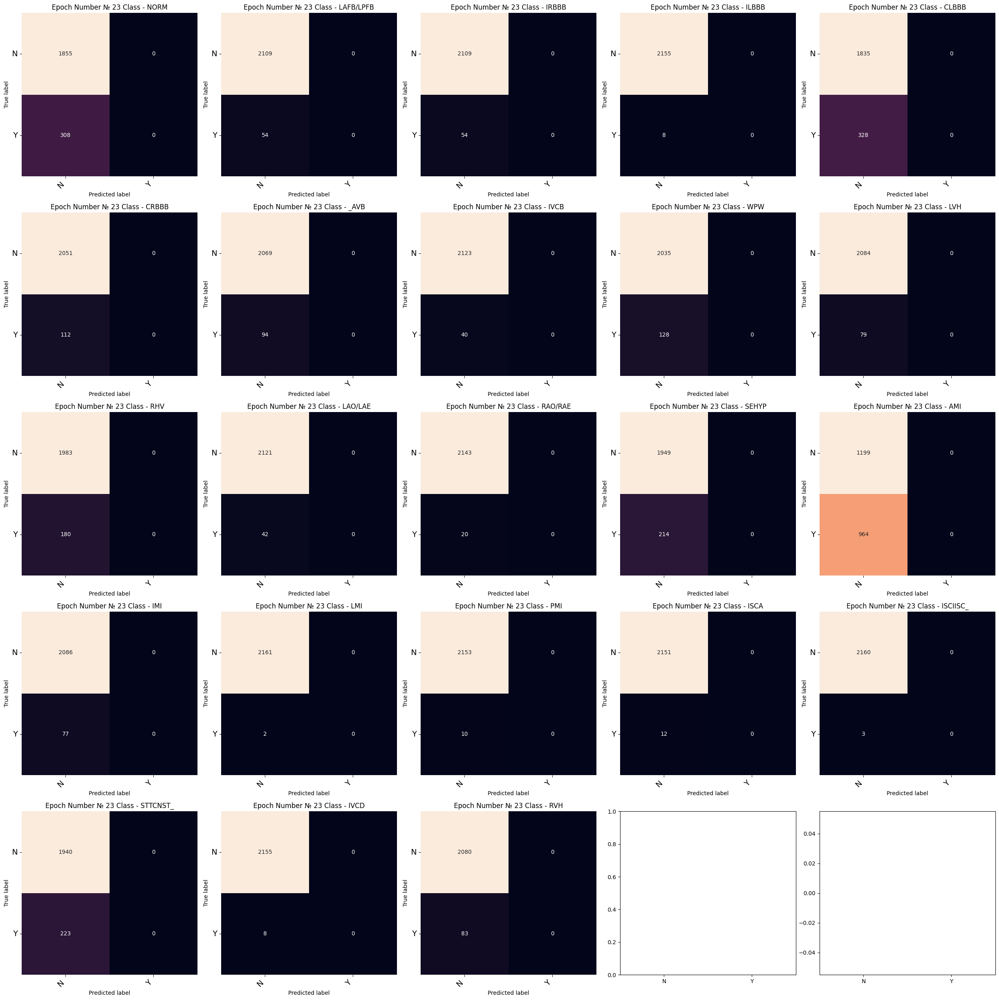

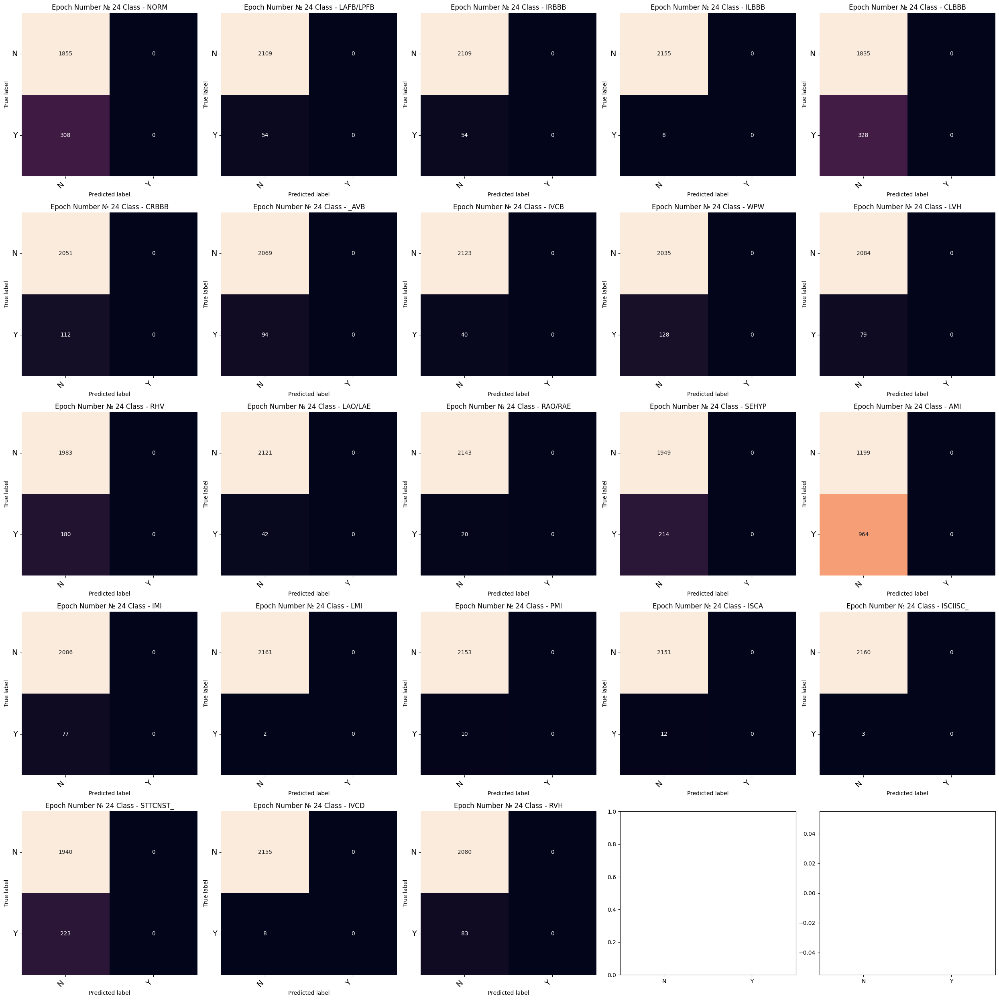

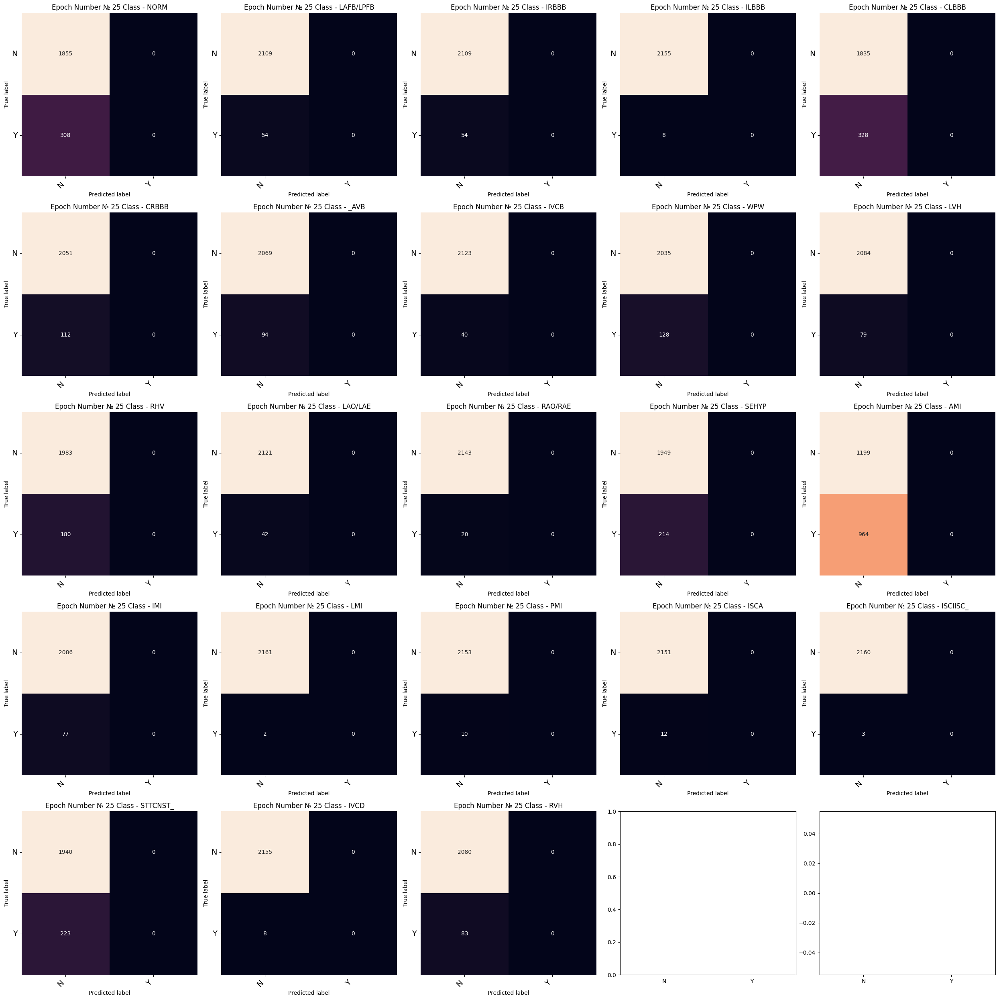

In [124]:
labels = ['NORM','LAFB/LPFB', 'IRBBB', 'ILBBB', 'CLBBB', 'CRBBB', '_AVB', 'IVCB', 'WPW', 'LVH', 'RHV', 'LAO/LAE', 'RAO/RAE', 'SEHYP', 'AMI', 'IMI', 'LMI', 'PMI','ISCA','ISCI''ISC_','STTC''NST_','IVCD','RVH']
index = 1
print(f"------------------CONFUSION MATRIX FOR EPOCHS ---------------------")
for cm in cm_arr:
    fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")
    for axes, cfs_matrix, label in zip(ax.flatten(), cm, labels):
        print_confusion_matrix(cfs_matrix, axes, label, ["N", "Y"], index)
    fig.tight_layout()
    plt.plot()
    index +=1

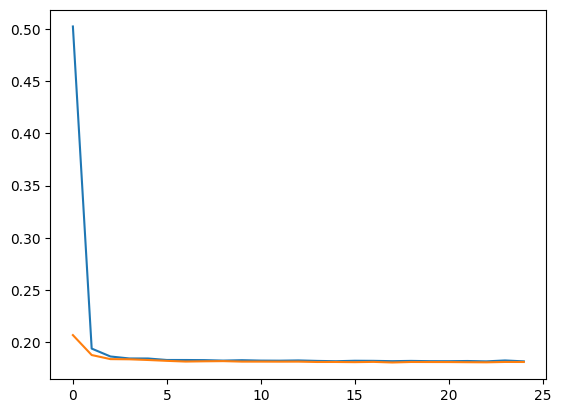

In [125]:
plt.plot(loss_train_4)
plt.plot(loss_test_4)
plt.show()

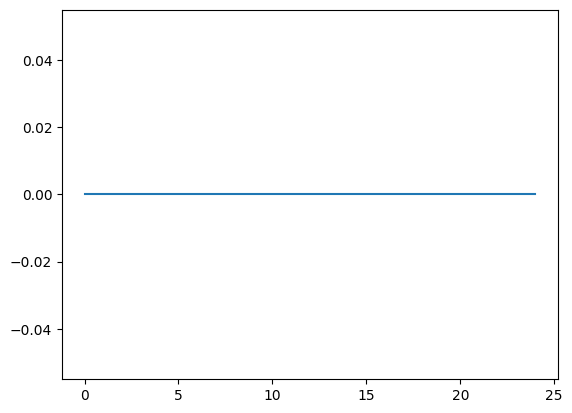

In [126]:
plt.plot(acc_4)
plt.show()

In [34]:
from sklearn.metrics import confusion_matrix, accuracy_score
from torch.utils.data import TensorDataset, DataLoader

batch_size = 64
input_shape = X_train.shape[1]

X_train=X_train.reshape(X_train.shape[0],1,12000)
X_test=X_test.reshape(X_test.shape[0],1,12000)

X_train_tensor = torch.Tensor(X_train)
Y_train_tensor = torch.LongTensor(Y_train)

train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size = batch_size, shuffle = True)

X_test_tensor = torch.Tensor(X_test)
Y_test_tensor = torch.LongTensor(Y_test)

test_dataset = TensorDataset(X_test_tensor, Y_test_tensor)
test_loader = DataLoader(test_dataset, batch_size = batch_size, shuffle = True)

In [35]:
X_train.shape

(15001, 1, 12000)

In [40]:
model6=nn.Sequential()
model6.add_module("conv1",nn.Conv1d(in_channels = 1, out_channels = 128, kernel_size = 8, padding="same"))
model6.add_module("bn1",nn.BatchNorm1d(128))
model6.add_module("relu1",nn.ReLU())
model6.add_module("conv2",nn.Conv1d(in_channels = 128, out_channels = 256, kernel_size = 5,padding="same"))
model6.add_module("bn2",nn.BatchNorm1d(256))
model6.add_module("relu2",nn.ReLU())
model6.add_module("conv3",nn.Conv1d(in_channels = 256, out_channels = 128, kernel_size = 3,padding="same"))
model6.add_module("bn3",nn.BatchNorm1d(128))
model6.add_module("AvgPool", nn.AvgPool1d(100))
model6.add_module("flattern", nn.Flatten())
model6.add_module("dense2", nn.Linear(15360,128))
model6.add_module("dense3", nn.Linear(128,23))
model6.add_module("softmax",nn.Sigmoid())

loss_function=nn.BCELoss()
optimizer = torch.optim.Adam(model6.parameters(), lr=0.0001)

In [43]:
loss_train_6=[]
loss_test_6=[]
acc_6=[]
cm_arr = []
for epoch in range(25):
    loss_train_6.append(train(epoch + 1,model6))
    acc_, test_loss_=test(model6)
    acc_6.append(acc_)
    loss_test_6.append(test_loss_)
    print("Accurancy {:.2f}%\n".format(100 * acc_))
    #cm_arr.append(calc_confusion_matrix(model6, X_test_tensor, Y_test_tensor))

Train Epoch: 1 [0/15001 (0%)]	Loss: 0.202002
Train Epoch: 1 [6400/15001 (43%)]	Loss: 0.169167
Train Epoch: 1 [12800/15001 (85%)]	Loss: 0.154991
Accurancy 19.45%

Train Epoch: 2 [0/15001 (0%)]	Loss: 0.160819
Train Epoch: 2 [6400/15001 (43%)]	Loss: 0.173270
Train Epoch: 2 [12800/15001 (85%)]	Loss: 0.146674
Accurancy 31.13%

Train Epoch: 3 [0/15001 (0%)]	Loss: 0.141360
Train Epoch: 3 [6400/15001 (43%)]	Loss: 0.118855
Train Epoch: 3 [12800/15001 (85%)]	Loss: 0.173840
Accurancy 22.15%

Train Epoch: 4 [0/15001 (0%)]	Loss: 0.146573
Train Epoch: 4 [6400/15001 (43%)]	Loss: 0.125757
Train Epoch: 4 [12800/15001 (85%)]	Loss: 0.142330
Accurancy 34.76%

Train Epoch: 5 [0/15001 (0%)]	Loss: 0.133723
Train Epoch: 5 [6400/15001 (43%)]	Loss: 0.131093
Train Epoch: 5 [12800/15001 (85%)]	Loss: 0.125361
Accurancy 34.87%

Train Epoch: 6 [0/15001 (0%)]	Loss: 0.124838
Train Epoch: 6 [6400/15001 (43%)]	Loss: 0.152464
Train Epoch: 6 [12800/15001 (85%)]	Loss: 0.145014
Accurancy 41.43%

Train Epoch: 7 [0/15001 (0%)

In [ ]:
labels = ['NORM','LAFB/LPFB', 'IRBBB', 'ILBBB', 'CLBBB', 'CRBBB', '_AVB', 'IVCB', 'WPW', 'LVH', 'RHV', 'LAO/LAE', 'RAO/RAE', 'SEHYP', 'AMI', 'IMI', 'LMI', 'PMI','ISCA','ISCI''ISC_','STTC''NST_','IVCD','RVH']
index = 1
print(f"------------------CONFUSION MATRIX FOR EPOCHS ---------------------")
for cm in cm_arr:
    fig, ax = plt.subplots(5, 5, figsize=(25, 25), sharex="row")
    for axes, cfs_matrix, label in zip(ax.flatten(), cm, labels):
        print_confusion_matrix(cfs_matrix, axes, label, ["N", "Y"], index)
    fig.tight_layout()
    plt.plot()
    index +=1